# 1. Import modules and load MERFISH data 

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import scanpy as sc
import os

import matplotlib.pyplot as plt

sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi=180, dpi_save=300, frameon=False, figsize=(4, 4), fontsize=8, facecolor='white')

# 2. Load MERLin analysis results

In [2]:
merlin_output_folder = r'\\mendel\Mendel_SSD3\MERFISH_Analysis\20220415-M1_renamed_storm65'
# generate post-analysis folders
postanalysis_folder = os.path.join(merlin_output_folder, 'PostAnalysis')
if not os.path.exists(postanalysis_folder):
    print(f"Create postanalysis_folder: {postanalysis_folder}")
    os.makedirs(postanalysis_folder)
else:
    print(f"Use postanalysis_folder: {postanalysis_folder}")

Use postanalysis_folder: \\mendel\Mendel_SSD3\MERFISH_Analysis\20220415-M1_renamed_storm65\PostAnalysis


In [27]:
seg_file = r'\\mendel\Mendel_SSD3\MERFISH_Analysis\20220415-M1_renamed_storm65\CellPoseSegment\features\feature_data_1.hdf5'

import h5py
with h5py.File(seg_file, 'r') as _f:
    seg_label = _f['labeldata']['label3D'][:]

In [1]:
%run "..\..\Startup_py3.py"
sys.path.append(r"..\..\..\..\Documents")

import ImageAnalysis3 as ia
%matplotlib notebook

from ImageAnalysis3 import *
print(os.getpid())

import h5py
from ImageAnalysis3.classes import _allowed_kwds
import ast

26396


In [2]:
import cv2

In [3]:
data_folder = r'Z:\20220415-P_brain_M1_noclear_storm65'

folders, fovs = ia.io_tools.data.get_folders(data_folder)

dapi_image_file = os.path.join(data_folder, 'H0M1', 'Conv_zscan_001.dax')
#dapi_im = visual_tools.DaxReader(dapi_image_file).loadAll()[3::4][0::4]
#dapi_im = im[3::4]#[::4]

Get Folder Names: (ia.get_img_info.get_folders)
- Number of folders: 12
- Number of field of views: 217


In [4]:
correction_folder = r'\\10.245.74.158\Chromatin_NAS_0\Corrections\20210621-Corrections_lumencor_from_60_to_50'

segmentation_save_folder = os.path.join(data_folder, 'Segmentation')
if not os.path.exists(segmentation_save_folder):
    os.makedirs(segmentation_save_folder)
from cellpose import models

from ImageAnalysis3.segmentation_tools.cell import Align_Segmentation
reload(ia.segmentation_tools.cell)

# transpose with microscope
microscope_file = r'\\mendel\pu_documents\Merfish_analysis\Merfish_Analysis_Scripts\merlin_parameters\microscope\storm65_microscope.json'
microscope_params = Align_Segmentation._read_microscope_json(microscope_file)


In [9]:

for _fov_id, _fov_name in enumerate(fovs):
    
    seg_save_file = os.path.join(segmentation_save_folder, f'segmentation_label_{_fov_id}.npy')
    if os.path.exists(seg_save_file):
        continue

    dapi_image_file = os.path.join(folders[0], _fov_name)
    polyt_image_file = os.path.join(folders[-1], _fov_name)
    print(dapi_image_file, polyt_image_file)
    # load reference DAPI
    _ref_cls = ia.classes.preprocess.DaxProcesser(dapi_image_file, 
                                                 CorrectionFolder=correction_folder, DriftChannel=488, DapiChannel=405)
    _ref_cls._load_image(sel_channels=[750,488,405])
    _ref_cls._corr_illumination()
    _ref_im = _ref_cls.im_488[0::4]
    # load polyT
    _cls = ia.classes.preprocess.DaxProcesser(polyt_image_file, 
                                              CorrectionFolder=correction_folder, DriftChannel=488, DapiChannel=405)
    _cls._load_image(sel_channels=[750,488])
    _cls._corr_illumination()
    _cls._calculate_drift(_ref_im)
    _cls._warp_image(corr_chromatic=False)
    # cellpose
    print(f"- apply microscope corrections")
    test_dapi_im = Align_Segmentation._correct_image3D_by_microscope_param(_ref_cls.im_405[0::4], microscope_params)
    test_polyt_im = Align_Segmentation._correct_image3D_by_microscope_param(_cls.im_750, microscope_params)
    
    print(f"- run Cellpose segmentation", end=' ')
    _cellpose_start = time.time()
    test_dapi_im = np.array([cv2.resize(_ly, (1024,1024) ) for _ly in test_dapi_im])
    test_polyt_im = np.array([cv2.resize(_ly, (1024,1024) ) for _ly in test_polyt_im])

    seg_model = models.CellposeModel(gpu=True, model_type='TN2')

    labels3d, _, _ = seg_model.eval(np.stack([test_polyt_im, test_dapi_im], axis=3), 
                                    batch_size=20, anisotropy=1000/108/2,
                                    cellprob_threshold=0, 
                                    channels=[1,2], diameter=30, min_size=100,
                                    do_3D=True,
                                    )

    print(f"in {time.time()-_cellpose_start:.3f}s.")
    
    
    # resize segmentation label back
    labels3d = np.array([cv2.resize(_ly, _cls.im_750.shape[1:], 
                                    interpolation=cv2.INTER_NEAREST_EXACT) 
                         for _ly in labels3d])

    
    print(labels3d.shape, _fov_id)
    # save this segmentation mask
    print(f"- save to file: {seg_save_file}")
    np.save(seg_save_file.split('.npy')[0], labels3d, )


Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_002.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_002.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_002.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 5.969s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.891s.
-- corrected illumination for channel 488 in 7.875s.
-- corrected illumination for channel 405 in 7.735s.
- Finished illumination correction in 23.752s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_002.dax
-- all used channels: ['750', '647', '488']
-- single 

-- corrected illumination for channel 488 in 2.063s.
- Finished illumination correction in 4.407s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [-0.02 -3.43  3.55] in 0.812s.
-- drift 1: [-0.01 -3.39  3.48] in 0.844s.
-- drift 2: [ 0.   -3.43  3.54] in 0.829s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[-0.01       -3.41666667  3.52333333] for channel: 750
-- finish warpping channel 750 in 21.719s.
488 False True
-- warp image with drift:[-0.01       -3.41666667  3.52333333] for channel: 488
-- finish warpping channel 488 in 21.893s.
-- finish warpping in 43.612s.
- apply microscope corrections
- start Cellpose segmentation in 54.020s.
(13, 2048, 2048) 5
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_5.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_006.dax Z:

	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.845s.
-- corrected illumination for channel 488 in 7.828s.
-- corrected illumination for channel 405 in 7.829s.
- Finished illumination correction in 23.752s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_009.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 1.672s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 2.047s.
-- corrected illumination for channel 488 in 2.047s.
- Finished illumination correction in 4.407s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference i

-- finish warpping channel 750 in 22.143s.
488 False True
-- warp image with drift:[ 0.         -4.02        3.15666667] for channel: 488
-- finish warpping channel 488 in 22.517s.
-- finish warpping in 44.660s.
- apply microscope corrections
- start Cellpose segmentation in 54.435s.
(13, 2048, 2048) 12
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_12.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_013.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_013.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_013.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 4.078s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 i

- Loaded images for channels:['750', '488'] in 0.963s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 1.978s.
-- corrected illumination for channel 488 in 2.016s.
- Finished illumination correction in 4.168s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [ 0.01 -3.6   3.77] in 0.858s.
-- drift 1: [ 0.02 -3.58  3.69] in 0.877s.
-- drift 2: [ 0.02 -3.57  3.73] in 0.891s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[ 0.01666667 -3.58333333  3.73      ] for channel: 750
-- finish warpping channel 750 in 22.376s.
488 False True
-- warp image with drift:[ 0.01666667 -3.58333333  3.73      ] for channel: 488
-- fi

- Loaded images for channels:['750', '488', '405'] in 6.154s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 8.062s.
-- corrected illumination for channel 488 in 8.102s.
-- corrected illumination for channel 405 in 7.938s.
- Finished illumination correction in 24.447s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_020.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 1.437s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumi

-- warp image with drift:[-0.00666667 -3.31        3.88333333] for channel: 750
-- finish warpping channel 750 in 21.964s.
488 False True
-- warp image with drift:[-0.00666667 -3.31        3.88333333] for channel: 488
-- finish warpping channel 488 in 22.007s.
-- finish warpping in 43.971s.
- apply microscope corrections
- start Cellpose segmentation in 55.503s.
(13, 2048, 2048) 23
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_23.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_024.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_024.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_024.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 4.266s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_corr

- Loaded images for channels:['750', '488'] in 1.813s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 1.983s.
-- corrected illumination for channel 488 in 2.000s.
- Finished illumination correction in 4.266s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [ 0.   -3.21  4.12] in 0.828s.
-- drift 1: [ 0.01 -3.19  4.11] in 0.844s.
-- drift 2: [ 0.02 -3.23  4.12] in 0.828s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[ 0.01       -3.21        4.11666667] for channel: 750
-- finish warpping channel 750 in 21.986s.
488 False True
-- warp image with drift:[ 0.01       -3.21        4.11666667] for channel: 488
-- fi

- Loaded images for channels:['750', '488', '405'] in 4.844s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.947s.
-- corrected illumination for channel 488 in 7.735s.
-- corrected illumination for channel 405 in 7.907s.
- Finished illumination correction in 23.798s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_031.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 1.922s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumi

-- warp image with drift:[-0.01333333 -3.14        3.70666667] for channel: 750
-- finish warpping channel 750 in 22.505s.
488 False True
-- warp image with drift:[-0.01333333 -3.14        3.70666667] for channel: 488
-- finish warpping channel 488 in 23.146s.
-- finish warpping in 45.651s.
- apply microscope corrections
- start Cellpose segmentation in 55.097s.
(13, 2048, 2048) 34
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_34.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_035.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_035.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_035.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 3.930s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_corr

- Loaded images for channels:['750', '488'] in 0.891s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 1.968s.
-- corrected illumination for channel 488 in 1.984s.
- Finished illumination correction in 4.156s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [-0.02 -3.81  3.08] in 0.844s.
-- drift 1: [ 0.   -3.81  3.04] in 0.860s.
-- drift 2: [ 0.   -3.71  3.12] in 0.876s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[-0.00666667 -3.77666667  3.08      ] for channel: 750
-- finish warpping channel 750 in 22.062s.
488 False True
-- warp image with drift:[-0.00666667 -3.77666667  3.08      ] for channel: 488
-- fi

- Loaded images for channels:['750', '488', '405'] in 4.277s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.807s.
-- corrected illumination for channel 488 in 8.001s.
-- corrected illumination for channel 405 in 7.461s.
- Finished illumination correction in 23.477s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_042.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 0.862s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumi

-- drift 2: [ 0.   -2.99  3.93] in 0.828s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[-3.33333333e-03 -3.03666667e+00  3.92000000e+00] for channel: 750
-- finish warpping channel 750 in 21.797s.
488 False True
-- warp image with drift:[-3.33333333e-03 -3.03666667e+00  3.92000000e+00] for channel: 488
-- finish warpping channel 488 in 22.047s.
-- finish warpping in 43.845s.
- apply microscope corrections
- start Cellpose segmentation in 53.580s.
(13, 2048, 2048) 45
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_45.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_046.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_046.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_046.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images

-- corrected illumination for channel 488 in 8.047s.
-- corrected illumination for channel 405 in 7.844s.
- Finished illumination correction in 24.001s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_049.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 0.875s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 1.953s.
-- corrected illumination for channel 488 in 1.984s.
- Finished illumination correction in 4.125s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [-0.03 -3.78  3.4 ] in 0.875s.
-- drift 1: [-0.03 -3.6   3.48] in 0.844s.
-- drift 2: [-0.02 -3.65  3.43] in 0.859s.
--- drifts for

- start Cellpose segmentation in 51.298s.
(13, 2048, 2048) 52
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_52.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_053.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_053.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_053.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 4.563s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.869s.
-- corrected illumination for channel 488 in 8.047s.
-- corrected illumination for channel 405 in 8.074s.
- Finished illumination correction in 24.30

-- corrected illumination for channel 750 in 2.046s.
-- corrected illumination for channel 488 in 2.017s.
- Finished illumination correction in 4.210s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [-0.02 -3.29  2.72] in 0.849s.
-- drift 1: [-0.01 -3.31  2.68] in 0.851s.
-- drift 2: [-0.01 -3.3   2.76] in 0.865s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[-0.01333333 -3.3         2.72      ] for channel: 750
-- finish warpping channel 750 in 22.344s.
488 False True
-- warp image with drift:[-0.01333333 -3.3         2.72      ] for channel: 488
-- finish warpping channel 488 in 22.724s.
-- finish warpping in 45.069s.
- apply microscope corrections
- start Cellpose segmentation in 54.718s.
(13, 2048, 2048) 56
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_56.npy
Z:\2022041

	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 8.014s.
-- corrected illumination for channel 488 in 8.220s.
-- corrected illumination for channel 405 in 7.703s.
- Finished illumination correction in 24.173s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_060.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 0.986s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 2.011s.
-- corrected illumination for channel 488 in 2.000s.
- Finished illumination correction in 4.168s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference i

-- finish warpping channel 750 in 22.282s.
488 False True
-- warp image with drift:[ 0.00333333 -3.28        2.18666667] for channel: 488
-- finish warpping channel 488 in 22.704s.
-- finish warpping in 44.986s.
- apply microscope corrections
- start Cellpose segmentation in 56.330s.
(13, 2048, 2048) 63
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_63.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_064.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_064.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_064.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 5.547s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 i

- Loaded images for channels:['750', '488'] in 0.828s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 1.953s.
-- corrected illumination for channel 488 in 1.985s.
- Finished illumination correction in 4.125s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [-0.02 -2.79  2.73] in 0.828s.
-- drift 1: [ 0.   -2.8   2.85] in 0.828s.
-- drift 2: [-0.01 -2.74  2.76] in 0.859s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[-0.01       -2.77666667  2.78      ] for channel: 750
-- finish warpping channel 750 in 21.938s.
488 False True
-- warp image with drift:[-0.01       -2.77666667  2.78      ] for channel: 488
-- fi

- Loaded images for channels:['750', '488', '405'] in 4.031s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.656s.
-- corrected illumination for channel 488 in 8.125s.
-- corrected illumination for channel 405 in 7.860s.
- Finished illumination correction in 23.954s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_071.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 1.109s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumi

-- drift 2: [ 0.01 -3.28  3.45] in 0.860s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[ 0.         -3.18666667  3.39666667] for channel: 750
-- finish warpping channel 750 in 21.875s.
488 False True
-- warp image with drift:[ 0.         -3.18666667  3.39666667] for channel: 488
-- finish warpping channel 488 in 21.985s.
-- finish warpping in 43.860s.
- apply microscope corrections
- start Cellpose segmentation in 53.626s.
(13, 2048, 2048) 74
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_74.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_075.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_075.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_075.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '4

-- corrected illumination for channel 488 in 7.906s.
-- corrected illumination for channel 405 in 7.703s.
- Finished illumination correction in 23.594s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_078.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 1.078s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 2.063s.
-- corrected illumination for channel 488 in 2.016s.
- Finished illumination correction in 4.234s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [-0.01 -4.1   1.64] in 0.828s.
-- drift 1: [ 0.   -4.03  1.61] in 0.844s.
-- drift 2: [-0.01 -4.05  1.67] in 0.828s.
--- drifts for

- start Cellpose segmentation in 53.376s.
(13, 2048, 2048) 81
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_81.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_082.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_082.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_082.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 3.954s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.703s.
-- corrected illumination for channel 488 in 7.844s.
-- corrected illumination for channel 405 in 8.001s.
- Finished illumination correction in 23.78

-- corrected illumination for channel 750 in 2.047s.
-- corrected illumination for channel 488 in 2.016s.
- Finished illumination correction in 4.362s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [-0.03 -2.77  2.8 ] in 0.828s.
-- drift 1: [-0.03 -2.79  2.83] in 0.844s.
-- drift 2: [-0.03 -2.86  2.86] in 0.828s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[-0.03       -2.80666667  2.83      ] for channel: 750
-- finish warpping channel 750 in 22.635s.
488 False True
-- warp image with drift:[-0.03       -2.80666667  2.83      ] for channel: 488
-- finish warpping channel 488 in 22.226s.
-- finish warpping in 44.860s.
- apply microscope corrections
- start Cellpose segmentation in 54.360s.
(13, 2048, 2048) 85
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_85.npy
Z:\2022041

	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.874s.
-- corrected illumination for channel 488 in 8.078s.
-- corrected illumination for channel 405 in 7.906s.
- Finished illumination correction in 24.078s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_089.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 1.725s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 1.994s.
-- corrected illumination for channel 488 in 1.984s.
- Finished illumination correction in 4.281s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference i

-- finish warpping channel 750 in 21.735s.
488 False True
-- warp image with drift:[-0.01333333 -2.97666667  2.86666667] for channel: 488
-- finish warpping channel 488 in 22.063s.
-- finish warpping in 43.797s.
- apply microscope corrections
- start Cellpose segmentation in 54.391s.
(13, 2048, 2048) 92
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_92.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_093.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_093.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_093.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 3.984s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 i

- Loaded images for channels:['750', '488'] in 0.766s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 2.125s.
-- corrected illumination for channel 488 in 2.000s.
- Finished illumination correction in 4.266s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [-0.01 -3.22  4.09] in 0.848s.
-- drift 1: [ 0.03 -3.17  4.09] in 0.823s.
-- drift 2: [ 0.01 -3.16  4.15] in 0.828s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[ 0.01       -3.18333333  4.11      ] for channel: 750
-- finish warpping channel 750 in 21.922s.
488 False True
-- warp image with drift:[ 0.01       -3.18333333  4.11      ] for channel: 488
-- fi

- Loaded images for channels:['750', '488', '405'] in 6.186s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.797s.
-- corrected illumination for channel 488 in 7.828s.
-- corrected illumination for channel 405 in 7.813s.
- Finished illumination correction in 23.688s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_100.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 1.015s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumi

-- warp image with drift:[-0.01333333 -2.37666667  1.71666667] for channel: 750
-- finish warpping channel 750 in 21.735s.
488 False True
-- warp image with drift:[-0.01333333 -2.37666667  1.71666667] for channel: 488
-- finish warpping channel 488 in 22.094s.
-- finish warpping in 43.829s.
- apply microscope corrections
- start Cellpose segmentation in 51.329s.
(13, 2048, 2048) 103
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_103.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_104.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_104.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_104.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 6.828s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_co

- Loaded images for channels:['750', '488'] in 1.047s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 2.062s.
-- corrected illumination for channel 488 in 2.047s.
- Finished illumination correction in 4.297s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [ 0.01 -3.05  4.  ] in 0.844s.
-- drift 1: [ 0.01 -3.02  4.08] in 0.860s.
-- drift 2: [-0.01 -2.51  3.57] in 0.828s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[ 3.33333333e-03 -2.86000000e+00  3.88333333e+00] for channel: 750
-- finish warpping channel 750 in 21.828s.
488 False True
-- warp image with drift:[ 3.33333333e-03 -2.86000000e+00  3.88333333e+00

- Loaded images for channels:['750', '488', '405'] in 3.719s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.781s.
-- corrected illumination for channel 488 in 8.203s.
-- corrected illumination for channel 405 in 7.750s.
- Finished illumination correction in 24.047s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_111.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 1.734s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumi

-- warp image with drift:[ 0.         -2.55666667  3.24333333] for channel: 750
-- finish warpping channel 750 in 21.969s.
488 False True
-- warp image with drift:[ 0.         -2.55666667  3.24333333] for channel: 488
-- finish warpping channel 488 in 22.157s.
-- finish warpping in 44.126s.
- apply microscope corrections
- start Cellpose segmentation in 51.782s.
(13, 2048, 2048) 114
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_114.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_115.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_115.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_115.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 3.797s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_co

- Loaded images for channels:['750', '488'] in 1.313s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 2.077s.
-- corrected illumination for channel 488 in 2.047s.
- Finished illumination correction in 4.266s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [-0.02 -2.08  2.47] in 0.875s.
-- drift 1: [-0.01 -2.17  2.47] in 0.844s.
-- drift 2: [ 0.   -2.14  2.58] in 0.828s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[-0.01       -2.13        2.50666667] for channel: 750
-- finish warpping channel 750 in 21.750s.
488 False True
-- warp image with drift:[-0.01       -2.13        2.50666667] for channel: 488
-- fi

- Loaded images for channels:['750', '488', '405'] in 4.422s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.797s.
-- corrected illumination for channel 488 in 8.017s.
-- corrected illumination for channel 405 in 7.858s.
- Finished illumination correction in 23.891s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_122.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 1.203s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumi

-- warp image with drift:[-0.02       -2.55        4.69333333] for channel: 750
-- finish warpping channel 750 in 21.875s.
488 False True
-- warp image with drift:[-0.02       -2.55        4.69333333] for channel: 488
-- finish warpping channel 488 in 22.016s.
-- finish warpping in 43.891s.
- apply microscope corrections
- start Cellpose segmentation in 54.594s.
(13, 2048, 2048) 125
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_125.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_126.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_126.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_126.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 6.391s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_co

- Loaded images for channels:['750', '488'] in 0.938s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 2.000s.
-- corrected illumination for channel 488 in 2.016s.
- Finished illumination correction in 4.156s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [-0.03 -2.06  2.41] in 0.888s.
-- drift 1: [-0.04 -2.06  2.37] in 0.845s.
-- drift 2: [-0.03 -2.06  2.38] in 0.828s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[-0.03333333 -2.06        2.38666667] for channel: 750
-- finish warpping channel 750 in 21.750s.
488 False True
-- warp image with drift:[-0.03333333 -2.06        2.38666667] for channel: 488
-- fi

-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 4.281s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.844s.
-- corrected illumination for channel 488 in 8.172s.
-- corrected illumination for channel 405 in 7.906s.
- Finished illumination correction in 24.187s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_133.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 0.797s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correctio

-- drift 2: [ 0.03 -1.71  3.83] in 0.844s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[ 0.03       -1.71        3.76666667] for channel: 750
-- finish warpping channel 750 in 21.844s.
488 False True
-- warp image with drift:[ 0.03       -1.71        3.76666667] for channel: 488
-- finish warpping channel 488 in 22.110s.
-- finish warpping in 43.953s.
- apply microscope corrections
- start Cellpose segmentation in 53.922s.
(13, 2048, 2048) 136
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_136.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_137.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_137.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_137.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', 

-- corrected illumination for channel 750 in 7.906s.
-- corrected illumination for channel 488 in 7.891s.
-- corrected illumination for channel 405 in 7.750s.
- Finished illumination correction in 23.797s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_140.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 0.908s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 1.965s.
-- corrected illumination for channel 488 in 2.031s.
- Finished illumination correction in 4.156s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [-0.01 -2.52  2.96] in 0.859s.
-- drift 1: [-0.02 -2.5   3.15] in 0.844s.
-- d

-- finish warpping channel 488 in 22.172s.
-- finish warpping in 44.594s.
- apply microscope corrections
- start Cellpose segmentation in 54.580s.
(13, 2048, 2048) 143
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_143.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_144.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_144.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_144.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 5.547s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.917s.
-- corrected illumination for channel 488 

-- corrected illumination for channel 750 in 1.969s.
-- corrected illumination for channel 488 in 1.977s.
- Finished illumination correction in 4.133s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [-0.03 -1.73  2.58] in 0.851s.
-- drift 1: [-0.02 -1.82  2.38] in 0.859s.
-- drift 2: [-0.02 -1.78  2.56] in 0.828s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[-0.02333333 -1.77666667  2.50666667] for channel: 750
-- finish warpping channel 750 in 22.125s.
488 False True
-- warp image with drift:[-0.02333333 -1.77666667  2.50666667] for channel: 488
-- finish warpping channel 488 in 22.094s.
-- finish warpping in 44.219s.
- apply microscope corrections
- start Cellpose segmentation in 54.735s.
(13, 2048, 2048) 147
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_147.npy
Z:\20220

- Loaded images for channels:['750', '488', '405'] in 6.047s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.813s.
-- corrected illumination for channel 488 in 8.109s.
-- corrected illumination for channel 405 in 7.859s.
- Finished illumination correction in 24.013s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_151.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 0.813s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumi

-- warp image with drift:[-0.00666667 -2.62666667  0.78333333] for channel: 750
-- finish warpping channel 750 in 22.047s.
488 False True
-- warp image with drift:[-0.00666667 -2.62666667  0.78333333] for channel: 488
-- finish warpping channel 488 in 22.594s.
-- finish warpping in 44.641s.
- apply microscope corrections
- start Cellpose segmentation in 55.156s.
(13, 2048, 2048) 154
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_154.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_155.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_155.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_155.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 4.411s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_co

- Loaded images for channels:['750', '488'] in 1.134s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 2.061s.
-- corrected illumination for channel 488 in 2.109s.
- Finished illumination correction in 4.328s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [-0.04 -2.23  2.76] in 0.860s.
-- drift 1: [-0.03 -2.23  2.96] in 0.843s.
-- drift 2: [-0.03 -2.27  2.99] in 0.884s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[-0.03333333 -2.24333333  2.90333333] for channel: 750
-- finish warpping channel 750 in 22.085s.
488 False True
-- warp image with drift:[-0.03333333 -2.24333333  2.90333333] for channel: 488
-- fi

- Loaded images for channels:['750', '488', '405'] in 5.799s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.934s.
-- corrected illumination for channel 488 in 7.921s.
-- corrected illumination for channel 405 in 7.719s.
- Finished illumination correction in 23.828s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_162.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 1.078s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumi

-- warp image with drift:[ 0.00666667 -2.74333333  2.11666667] for channel: 750
-- finish warpping channel 750 in 22.109s.
488 False True
-- warp image with drift:[ 0.00666667 -2.74333333  2.11666667] for channel: 488
-- finish warpping channel 488 in 22.392s.
-- finish warpping in 44.501s.
- apply microscope corrections
- start Cellpose segmentation in 49.610s.
(13, 2048, 2048) 165
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_165.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_166.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_166.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_166.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 6.620s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_co

- Loaded images for channels:['750', '488'] in 0.951s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 2.199s.
-- corrected illumination for channel 488 in 2.051s.
- Finished illumination correction in 4.422s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [-0.01 -2.3   2.87] in 0.844s.
-- drift 1: [-0.01 -2.33  2.88] in 0.829s.
-- drift 2: [-0.01 -2.35  2.87] in 0.843s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[-0.01       -2.32666667  2.87333333] for channel: 750
-- finish warpping channel 750 in 22.000s.
488 False True
-- warp image with drift:[-0.01       -2.32666667  2.87333333] for channel: 488
-- fi

- Loaded images for channels:['750', '488', '405'] in 4.378s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.856s.
-- corrected illumination for channel 488 in 7.875s.
-- corrected illumination for channel 405 in 7.844s.
- Finished illumination correction in 24.094s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_173.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 1.937s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumi

-- warp image with drift:[-0.02666667 -2.65        2.17333333] for channel: 750
-- finish warpping channel 750 in 22.219s.
488 False True
-- warp image with drift:[-0.02666667 -2.65        2.17333333] for channel: 488
-- finish warpping channel 488 in 22.283s.
-- finish warpping in 44.502s.
- apply microscope corrections
- start Cellpose segmentation in 54.578s.
(13, 2048, 2048) 176
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_176.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_177.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_177.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_177.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 6.984s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_co

- Loaded images for channels:['750', '488'] in 0.904s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 1.994s.
-- corrected illumination for channel 488 in 2.031s.
- Finished illumination correction in 4.219s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [ 0.   -2.74  2.54] in 0.829s.
-- drift 1: [ 0.01 -2.72  2.6 ] in 0.843s.
-- drift 2: [ 0.01 -2.75  2.64] in 0.844s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[ 0.00666667 -2.73666667  2.59333333] for channel: 750
-- finish warpping channel 750 in 22.031s.
488 False True
-- warp image with drift:[ 0.00666667 -2.73666667  2.59333333] for channel: 488
-- fi

- Loaded images for channels:['750', '488', '405'] in 5.297s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.838s.
-- corrected illumination for channel 488 in 7.946s.
-- corrected illumination for channel 405 in 7.915s.
- Finished illumination correction in 23.939s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_184.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 0.915s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumi

-- warp image with drift:[-0.03666667 -2.66       -0.57333333] for channel: 750
-- finish warpping channel 750 in 22.078s.
488 False True
-- warp image with drift:[-0.03666667 -2.66       -0.57333333] for channel: 488
-- finish warpping channel 488 in 22.392s.
-- finish warpping in 44.470s.
- apply microscope corrections
- start Cellpose segmentation in 55.423s.
(13, 2048, 2048) 187
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_187.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_188.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_188.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_188.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 4.969s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_co

- Loaded images for channels:['750', '488'] in 1.688s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 1.984s.
-- corrected illumination for channel 488 in 2.000s.
- Finished illumination correction in 4.297s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [-0.02 -2.83  3.62] in 0.857s.
-- drift 1: [-0.03 -2.82  3.62] in 0.844s.
-- drift 2: [-0.02 -2.75  3.62] in 0.855s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[-0.02333333 -2.8         3.62      ] for channel: 750
-- finish warpping channel 750 in 22.238s.
488 False True
-- warp image with drift:[-0.02333333 -2.8         3.62      ] for channel: 488
-- fi

- Loaded images for channels:['750', '488', '405'] in 5.641s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.828s.
-- corrected illumination for channel 488 in 7.941s.
-- corrected illumination for channel 405 in 7.872s.
- Finished illumination correction in 23.903s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_195.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 0.781s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumi

-- warp image with drift:[-0.02333333 -1.98333333  1.97666667] for channel: 750
-- finish warpping channel 750 in 22.172s.
488 False True
-- warp image with drift:[-0.02333333 -1.98333333  1.97666667] for channel: 488
-- finish warpping channel 488 in 22.313s.
-- finish warpping in 44.485s.
- apply microscope corrections
- start Cellpose segmentation in 54.329s.
(13, 2048, 2048) 198
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_198.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_199.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_199.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_199.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 5.968s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_co

- Loaded images for channels:['750', '488'] in 1.793s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 1.991s.
-- corrected illumination for channel 488 in 2.032s.
- Finished illumination correction in 4.259s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [ 0.   -1.61  2.6 ] in 0.751s.
-- drift 1: [ 0.   -1.65  2.76] in 0.829s.
-- drift 2: [ 0.01 -1.69  2.81] in 0.908s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[ 0.00333333 -1.65        2.72333333] for channel: 750
-- finish warpping channel 750 in 22.137s.
488 False True
-- warp image with drift:[ 0.00333333 -1.65        2.72333333] for channel: 488
-- fi

- Loaded images for channels:['750', '488', '405'] in 4.140s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
	 405 illumination_correction_405_2048x2048.npy
-- corrected illumination for channel 750 in 7.881s.
-- corrected illumination for channel 488 in 8.020s.
-- corrected illumination for channel 405 in 7.964s.
- Finished illumination correction in 24.119s.
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_206.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 1.001s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumi

-- warp image with drift:[-0.03666667 -1.82333333  2.97      ] for channel: 750
-- finish warpping channel 750 in 22.938s.
488 False True
-- warp image with drift:[-0.03666667 -1.82333333  2.97      ] for channel: 488
-- finish warpping channel 488 in 23.157s.
-- finish warpping in 46.094s.
- apply microscope corrections
- start Cellpose segmentation in 55.781s.
(13, 2048, 2048) 209
- save to file: Z:\20220415-P_brain_M1_noclear_storm65\Segmentation\segmentation_label_209.npy
Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_210.dax Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_210.dax
Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H0M1\Conv_zscan_210.dax
-- all used channels: ['750', '647', '488', '405']
-- single image size: [  50 2048 2048]
- Loaded images for channels:['750', '488', '405'] in 3.919s.
- Start illumination correction for channels:['750', '488', '405'].
-- loading illumination correction profile from file:
	 750 illumination_co

- Loaded images for channels:['750', '488'] in 0.906s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 2.026s.
-- corrected illumination for channel 488 in 2.075s.
- Finished illumination correction in 4.260s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [-0.03 -2.63  2.62] in 0.840s.
-- drift 1: [-0.03 -2.58  2.56] in 0.826s.
-- drift 2: [-0.01 -2.61  2.47] in 0.860s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[-0.02333333 -2.60666667  2.55      ] for channel: 750
-- finish warpping channel 750 in 22.296s.
488 False True
-- warp image with drift:[-0.02333333 -2.60666667  2.55      ] for channel: 488
-- fi

In [11]:
import tifffile

In [25]:
im_stack = tifffile.imread(r'\\mendel\Mendel_SSD3\MERFISH_Analysis\20220415-storm65_test\FiducialCorrelationWarp\images\aligned_images1.tif')

In [26]:
labels = np.load(r'\\mendel\Mendel_SSD3\MERFISH_Analysis\20220415-storm65_test\CellPoseSegment\segmentation_label\segmentation_label_1.npy')

In [27]:
with h5py.File(r'\\mendel\Mendel_SSD3\MERFISH_Analysis\20220415-storm65_test\CellPoseSegment\features\feature_data_1.hdf5') as _f:
    final_labels = _f['labeldata']['label3D'][:]


<IPython.core.display.Javascript object>


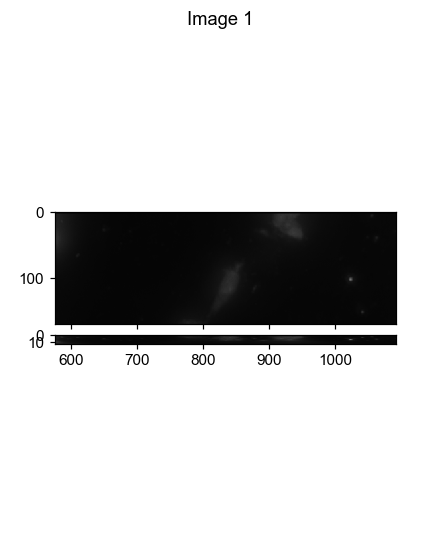

In [28]:
visual_tools.imshow_mark_3d_v2([im_stack[-26:-13], labels, final_labels])

## Load metadata

In [3]:
# Load Cell information
cell_meta_data_file = os.path.join(merlin_output_folder, 'ExportCellMetadata', 'feature_metadata.csv')
cell_meta_data = pd.read_csv(cell_meta_data_file)
cell_meta_data

,Unnamed: 0,fov,volume,center_x,center_y,min_x,max_x,min_y,max_y
0,102030849594294439404883248431608192665,0,357.760209,-1022.095948,-2706.492095,-1026.102748,-1018.089148,-2713.090895,-2699.893295
1,102136116970835349396542349102070461474,0,1258.674669,-1134.901951,-2687.484094,-1142.958751,-1126.845151,-2695.810895,-2679.157294
2,110001336844202410332514881384285978265,0,400.217871,-1092.943950,-2734.680096,-1097.814750,-1088.073150,-2739.874896,-2729.485295
3,112143141853469891090990881931237987313,0,1270.423350,-1121.293950,-2717.940095,-1128.702751,-1113.885150,-2727.238895,-2708.641295
4,124162854710953703783358604307852752803,0,1288.376697,-1084.951950,-2671.446094,-1092.846750,-1077.057149,-2682.094894,-2660.797294
...,...,...,...,...,...,...,...,...,...
19404,91983562792636916467633422503641931042,216,245.387711,1469.700060,-3587.992093,1465.315260,1474.084860,-3593.240893,-3582.743293
19405,92567908354085874492983212025570693034,216,1051.031431,1478.232060,-3555.862092,1472.227260,1484.236860,-3562.892893,-3548.831292
19406,96348048785320331951946539122414248214,216,73.891560,1567.116062,-3725.584097,1564.675262,1569.556862,-3729.212897,-3721.955297
19407,96453305092790210491081493576602363195,216,1391.587472,1506.960061,-3659.434095,1499.335260,1514.584861,-3667.760895,-3651.107295


In [12]:
reload(ia.classes.preprocess)


Initialize DaxProcesser for file:Z:\20220415-P_brain_M1_noclear_storm65\H11M12\Conv_zscan_001.dax
-- all used channels: ['750', '647', '488']
-- single image size: [  13 2048 2048]
- Loaded images for channels:['750', '488'] in 1.414s.
- Start illumination correction for channels:['750', '488'].
-- loading illumination correction profile from file:
	 750 illumination_correction_750_2048x2048.npy
	 488 illumination_correction_488_2048x2048.npy
-- corrected illumination for channel 750 in 1.830s.
-- corrected illumination for channel 488 in 1.933s.
- Finished illumination correction in 4.100s.
+ Calculate drift with drift_channel: 488
-- start aligning given source image to given reference image.
-- drift 0: [ 0.   -3.05  3.17] in 0.866s.
-- drift 1: [ 0.   -3.07  2.86] in 0.887s.
-- drift 2: [ 0.01 -3.07  3.17] in 0.948s.
--- drifts for crops:[0 1 2] pass the thresold, exit cycle.
- Start warpping images channels:['750', '488'].
750 False False
-- warp image with drift:[ 0.00333333 -3.0

In [4]:
# Load decoded counts information
counts_file_mer = os.path.join(merlin_output_folder, 'ExportPartitionedBarcodes', 'barcodes_per_feature.csv')
df = pd.read_csv(counts_file_mer).rename(columns={'Unnamed: 0':'index'}).set_index('index')
#blanks = [f'Blank-{i}' for i in range(1, 11)]
for _c in df.columns:
    if 'Blank-' in _c:
        df = df.drop(columns=_c)
adata = anndata.AnnData(df)
adata.obs = adata.obs.merge(cell_meta_data, left_index=True, right_on='Unnamed: 0').set_index('Unnamed: 0')

C:\Users\puzheng\AppData\Local\Temp/ipykernel_30876/376704491.py:8: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = anndata.AnnData(df)


In [5]:
df

,1700022I11Rik,1810046K07Rik,5031425F14Rik,5730522E02Rik,Acta2,Adam2,Adamts2,Adamts4,Adra1b,Alk,...,Unc13c,Unc5b,Unc5d,Ust,Vipr2,Vtn,Vwc2,Wipf3,Wnt7b,Zfp804b
index,,,,,,,,,,,,,,,,,,,,,
102030849594294439404883248431608192665,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,7.0,0.0,1.0,0.0,0.0
102136116970835349396542349102070461474,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
110001336844202410332514881384285978265,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
112143141853469891090990881931237987313,0.0,0.0,0.0,0.0,1.0,0.0,1.0,15.0,0.0,0.0,...,2.0,7.0,0.0,3.0,0.0,0.0,0.0,0.0,2.0,0.0
124162854710953703783358604307852752803,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91983562792636916467633422503641931042,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0
92567908354085874492983212025570693034,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
96348048785320331951946539122414248214,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


# 4. Preprocess and filter the MERFISH data 

In [6]:
# Calculate quality control metrics
sc.pp.calculate_qc_metrics(adata, percent_top=None, log1p=False, inplace=True)

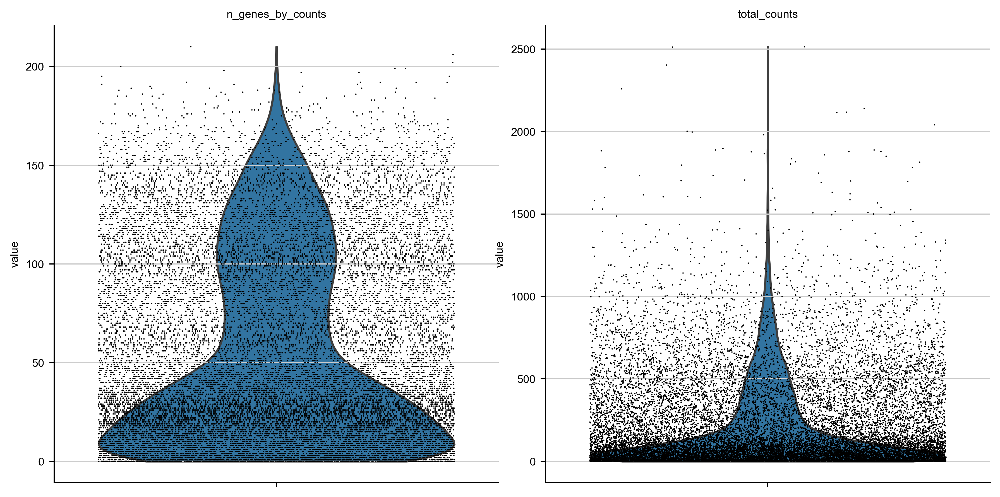

In [7]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

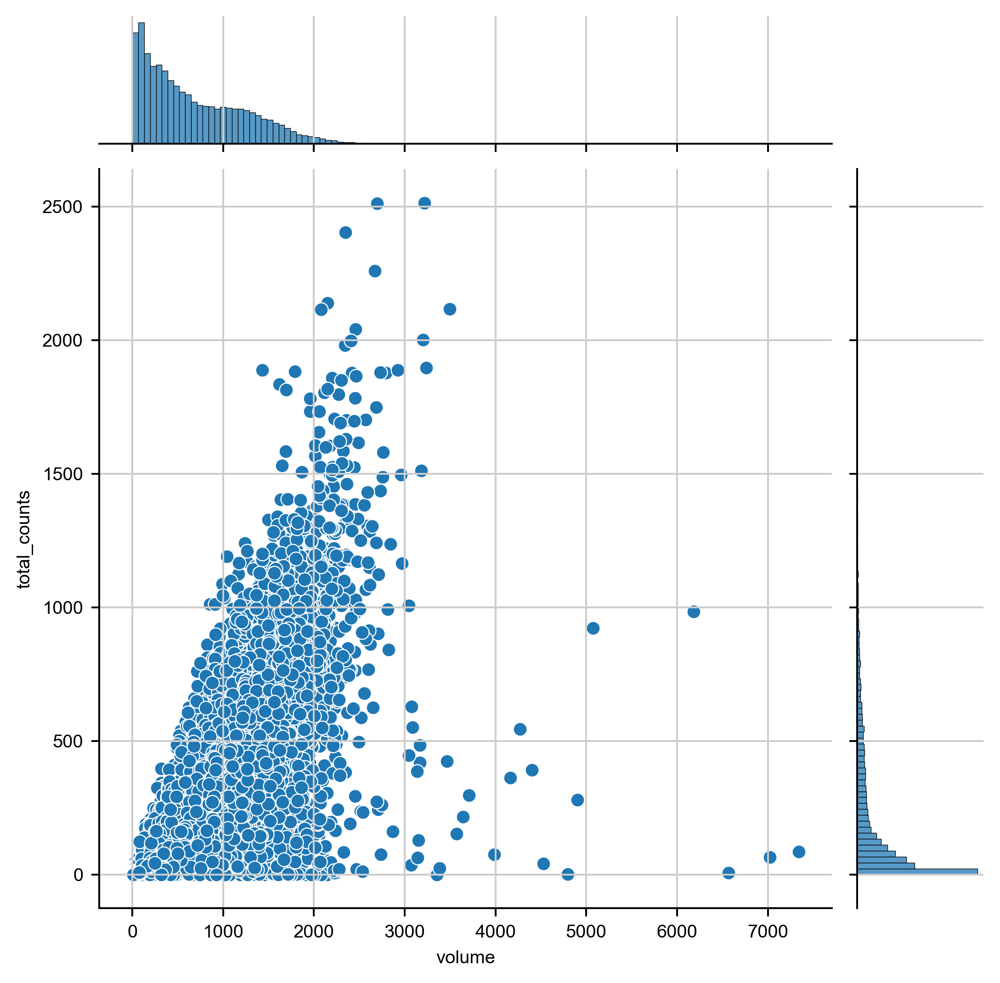

In [8]:
sns.jointplot(data=adata.obs, x='volume', y='total_counts')

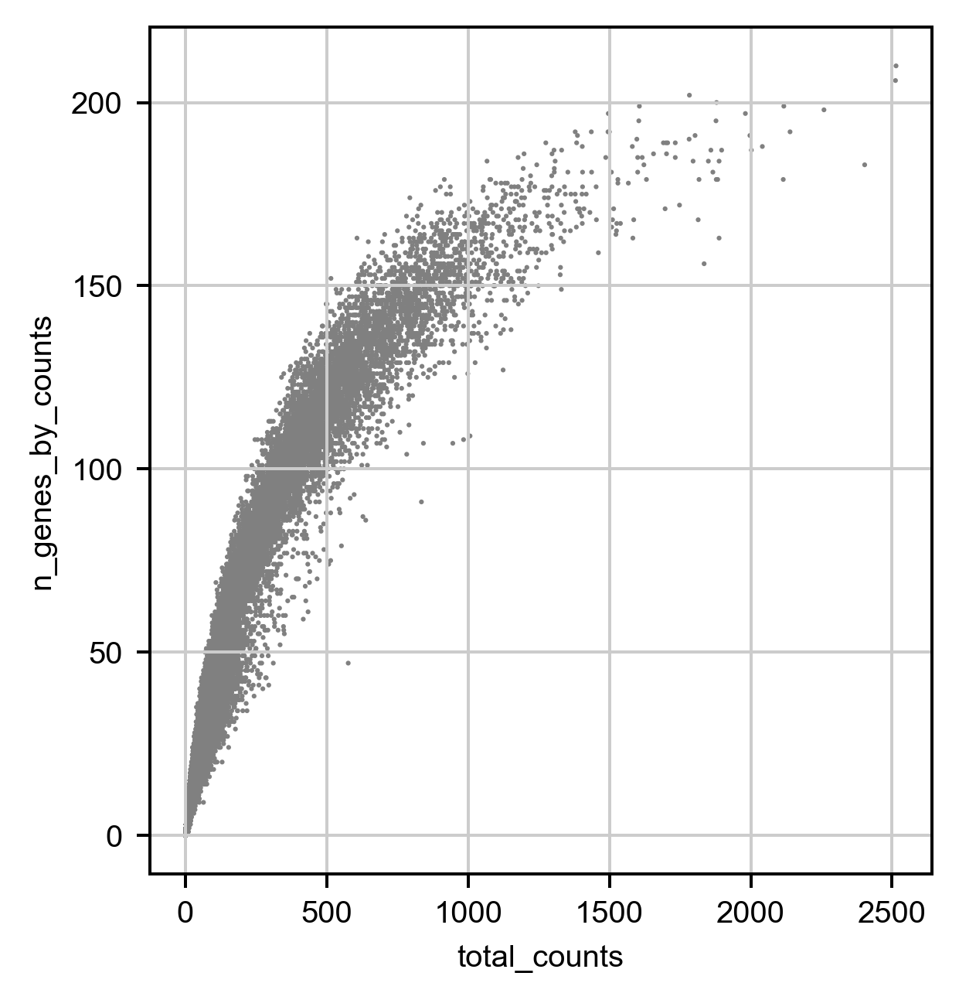

In [9]:
# Plot the distributions of gene counts
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [10]:
gene_count_threshold = 10
total_count_threshold = 20
volume_threshold = 100
volume_upper_threshold = 5000
# Filtering
adata = adata[adata.obs['n_genes_by_counts'] > gene_count_threshold]
adata = adata[adata.obs['total_counts'] > total_count_threshold]
adata = adata[adata.obs['volume'] > volume_threshold]
adata = adata[adata.obs['volume'] <= volume_upper_threshold]

print(len(adata) / len(cell_meta_data) , len(adata))

0.7722705961152043 14989


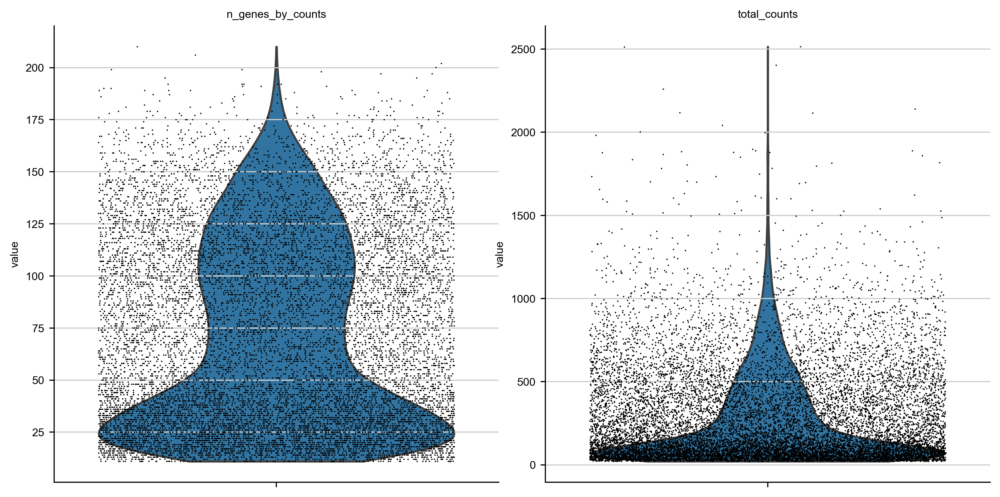

In [11]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

In [66]:
seg_model.eval?

In [12]:
np.mean(adata.obs['total_counts'])

281.1705322265625

## 4. PCA and UMAP of the MERFISH data (for quick test)

<IPython.core.display.Javascript object>


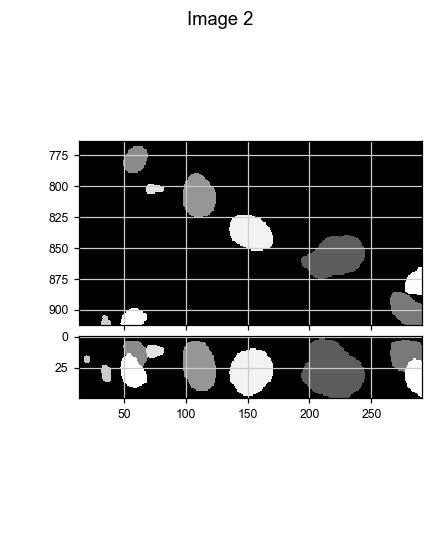

In [29]:
visual_tools.imshow_mark_3d_v2([test_dapi_im, masks, flows[0][:,:,:,0], flows[0][:,:,:,1],flows[0][:,:,:,2], flows[2]])

E:\Users\puzheng\anaconda3\envs\ia3_postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


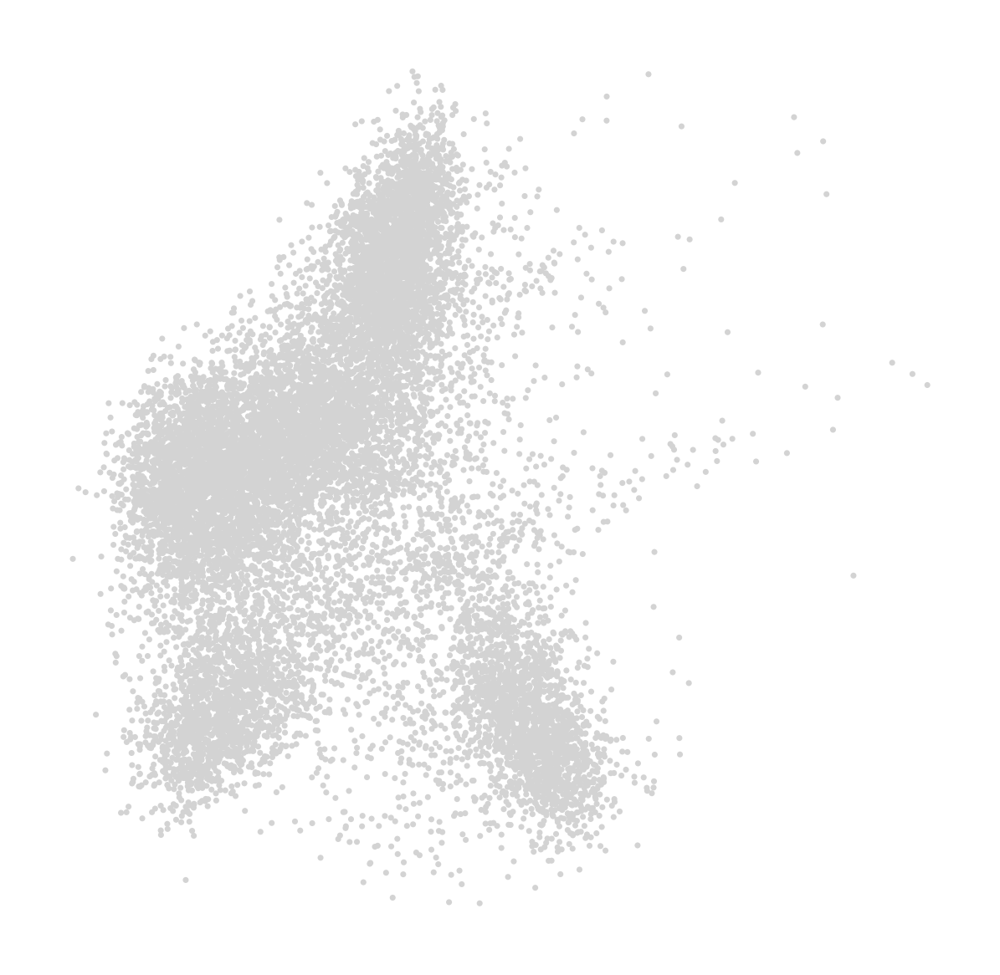

Wall time: 13.3 s


In [13]:
%%time
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
sc.pp.normalize_total(adata, target_sum=1e2)
# Logarithmize the data
sc.pp.log1p(adata)
# Regress out total counts
sc.pp.regress_out(adata, 'total_counts')
# Convert gene expressions to Z-scores
sc.pp.scale(adata, max_value=10)
# Principal component analysis
sc.tl.pca(adata, svd_solver='arpack')
# Plot the PCA results
sc.pl.pca(adata)

In [14]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=50)

Wall time: 16.1 s


In [15]:
%%time
# Clustering
sc.tl.leiden(adata, resolution=1)

Wall time: 1.89 s


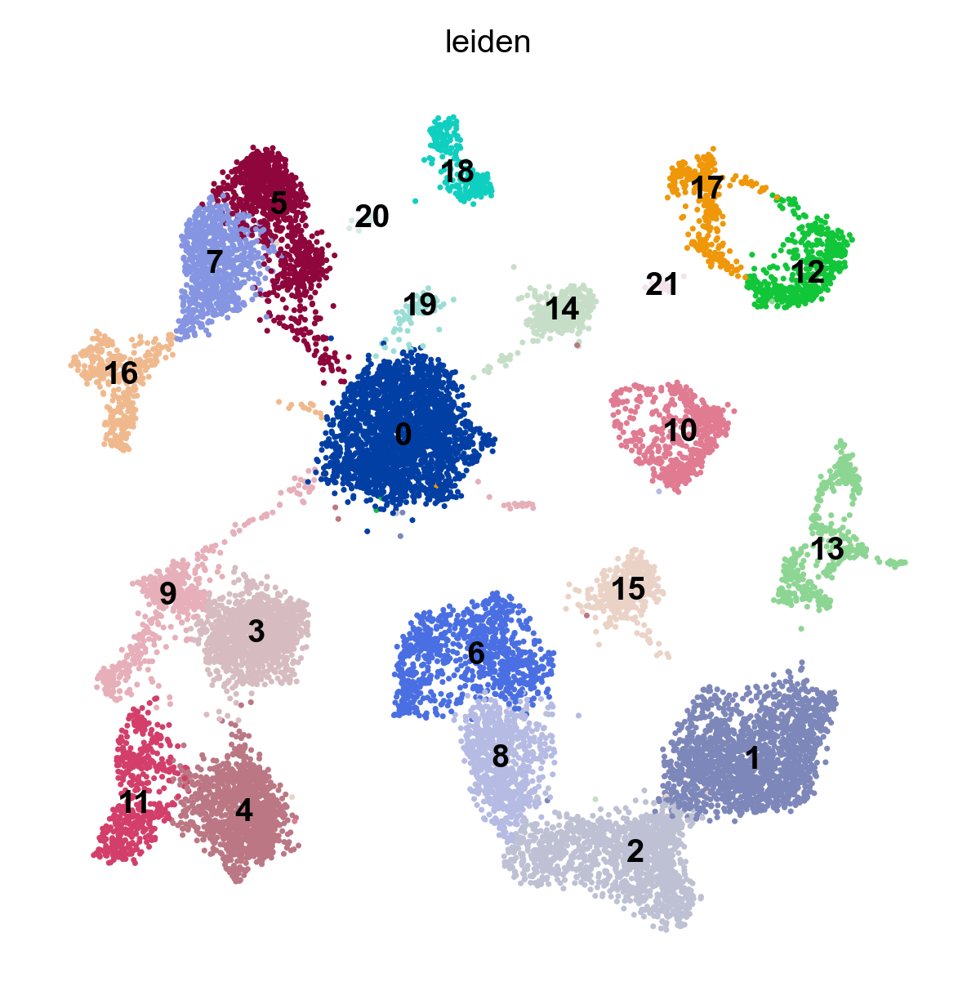

Wall time: 8.85 s


In [16]:
%%time
# Embed with UMAP
sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='leiden', legend_loc='on data')

(-2885.1828072914855, 5923.549105903692, -5086.822194940224, 850.5463945332915)

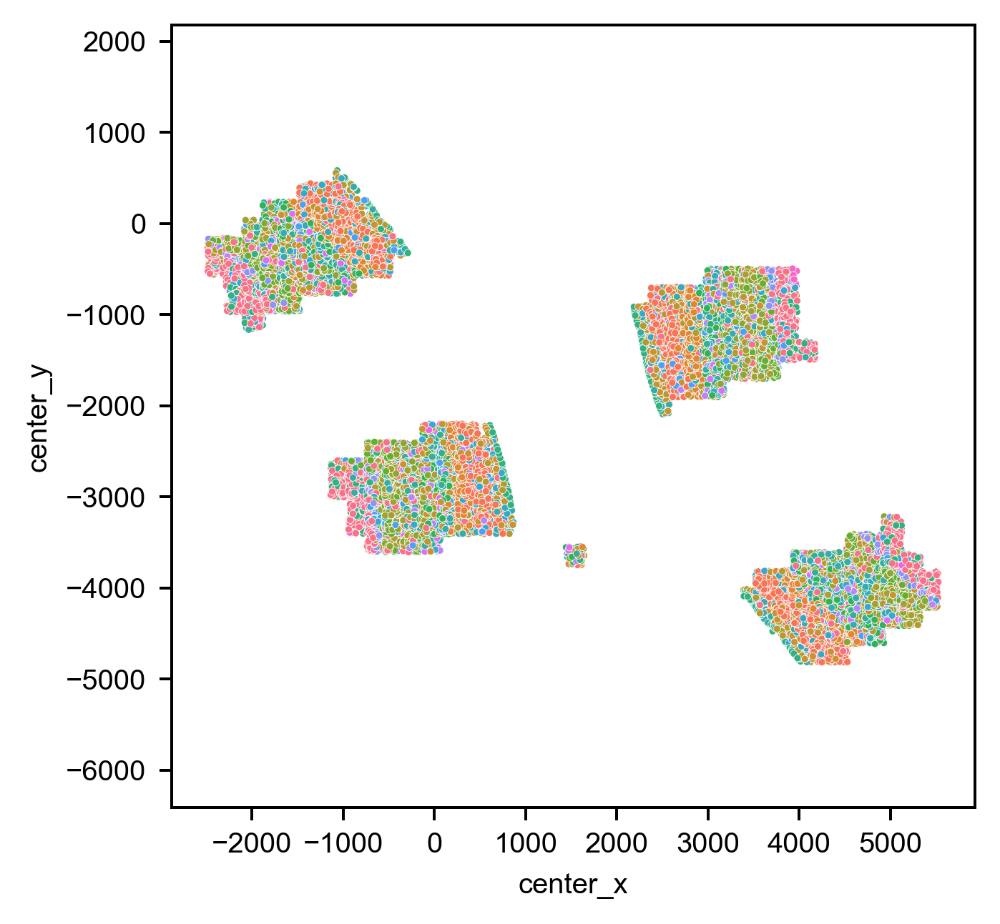

In [18]:
# visualzie the spatial dist for clusters
import matplotlib.pyplot as plt
#plt.style.use('dark_background')
ax = sns.scatterplot(data=adata.obs, x='center_x', y='center_y', 
                hue='leiden', s=4, legend=False)
ax.grid(False)
plt.axis('equal')
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])

## 5. Check count for each cell for genes of interest

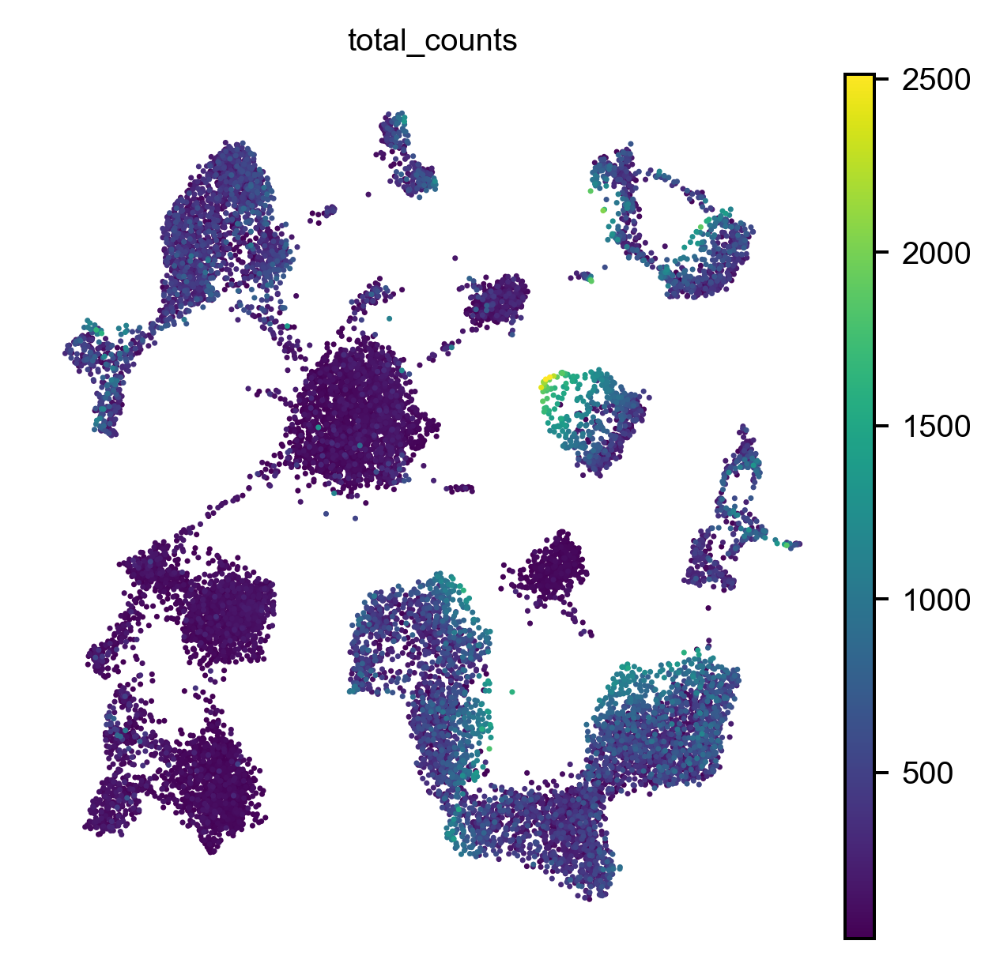

In [19]:
sc.pl.umap(adata, color='total_counts')

In [20]:
# 
marker_genes = ['Slc17a7', 'Slc30a3', 'Slc32a1', 'Cux2', 'Rorb', 'Rspo1','Otof','Sulf2', 'Ptpru', 'Car3', 'Fam84b', 'Syt6', 
               'Nxph4', 'Tshz2', 'Slc32a1', 'Pvalb', 'Sst', 'Vip', 'Sncg', 'Lamp5', 'Sox10', 'Pdgfra', 'Aqp4', 'Igf2',
               'Ctss', 'Cldn5', 'Flt1', 'Bgn', 'Vtn']
marker_genes = [g for g in marker_genes if (g in adata.var.index)]

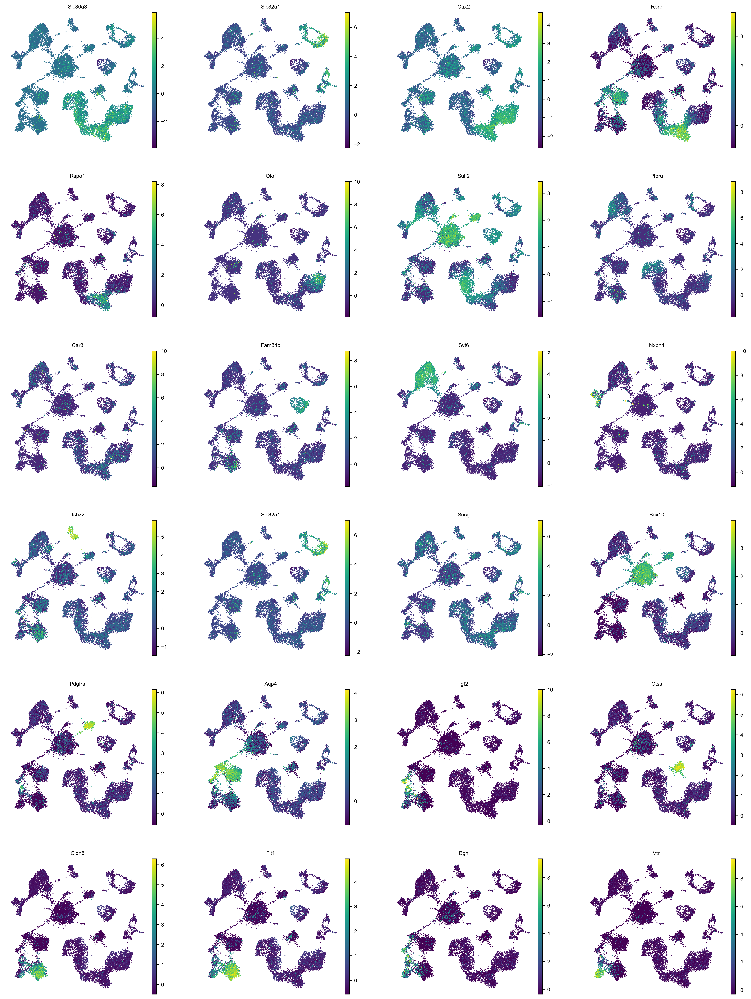

In [21]:
sc.pl.umap(adata, color=marker_genes)

## 6.UMAP can be done using different settings and can be saved into different label column for cell type classifer use later

## 6.1 Use higher expected pcs and resolution to UMAP for cell-type distinction at "cluster" level

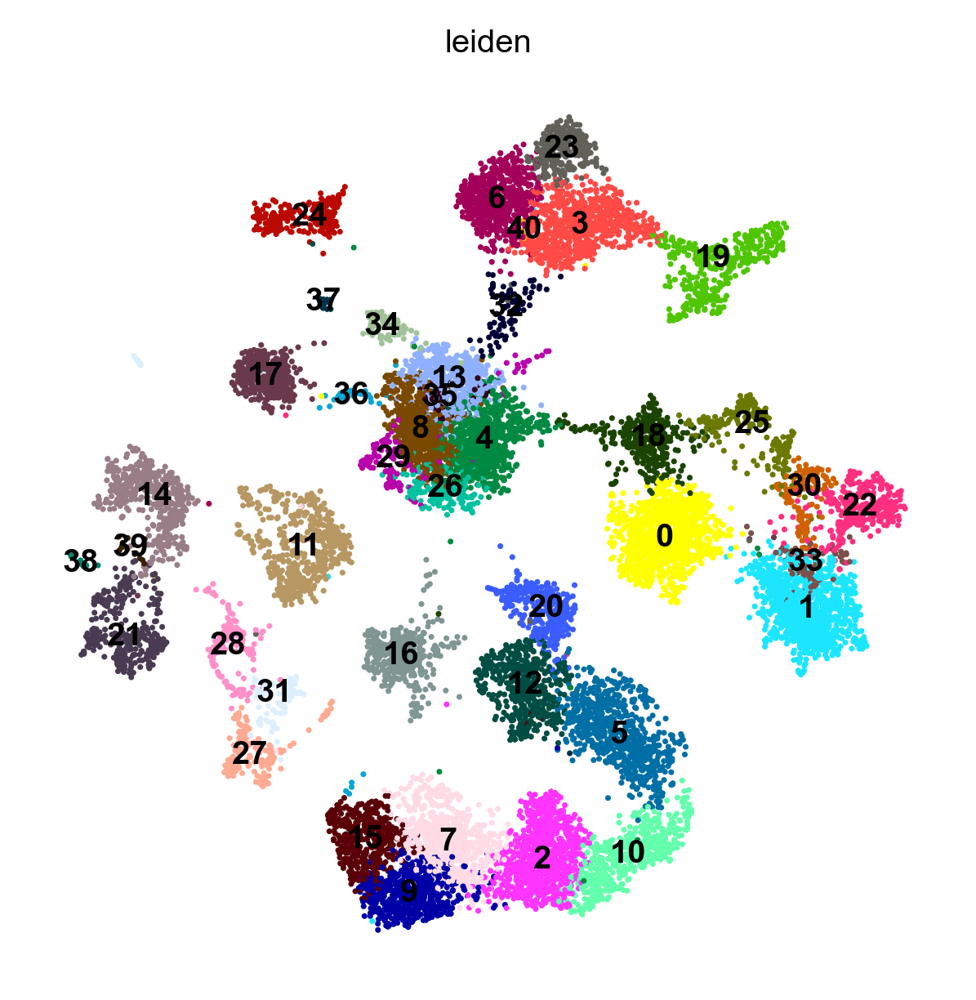

Wall time: 8.53 s


In [22]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(adata, n_neighbors=5, n_pcs=50)

sc.tl.leiden(adata, resolution=2)

sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='leiden', legend_loc='on data')

# save this labels as a new column as 'leiden_cluster'
adata.obs['leiden_cluster'] = adata.obs.leiden

## 6.2 Use lower expected pcs and resolution to UMAP for cell-type distinction at subclass level

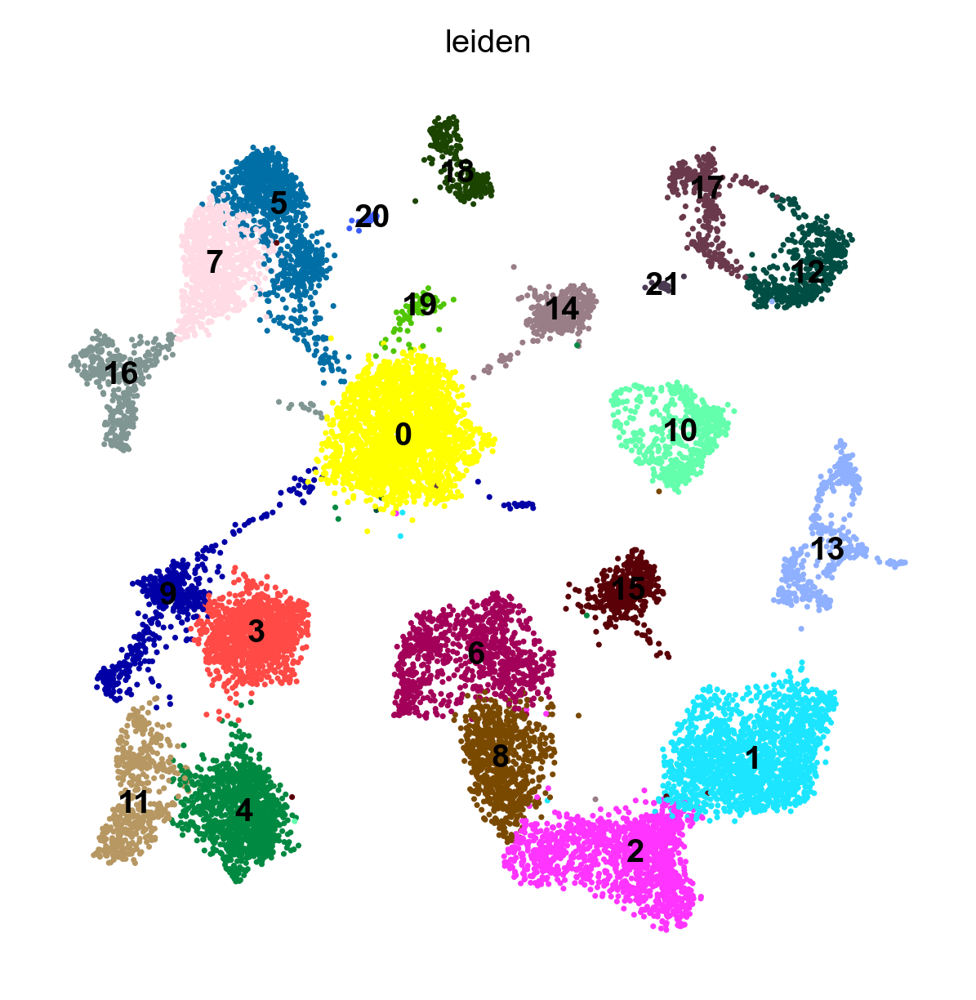

Wall time: 12.1 s


In [23]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=50)

sc.tl.leiden(adata, resolution=1)

sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='leiden', legend_loc='on data')

# save this new labels as a new column as 'leiden_subclass'
adata.obs['leiden_subclass'] = adata.obs.leiden

# 7. Save the analyzed MERFISH adata in h5ad for later use (e.g., cell classifer)

In [24]:
save_filename = os.path.join(os.path.join(postanalysis_folder, 'filtered_cluster_data.h5ad'))

overwrite = True

if not os.path.exists(save_filename) or overwrite:
    print(f"save adata into file: {save_filename}")
    adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save adata into file: \\mendel\Mendel_SSD3\MERFISH_Analysis\20220415-M1_renamed_storm65\PostAnalysis\filtered_cluster_data.h5ad


# 8. Cell type classifier

## 8.1 train classfier with Meng's dataset

In [25]:
meng_merfish_raw = r'\\mendel\Mendel_SSD3\MERFISH_Analysis\Meng_data\counts.h5ad'
merfish_raw = sc.read_h5ad(meng_merfish_raw)
meng_merfish_label = r'\\mendel\Mendel_SSD3\MERFISH_Analysis\Meng_data\cell_labels.csv'
merfish_label = pd.read_csv(meng_merfish_label, index_col=0)

In [26]:
merData = pd.DataFrame(merfish_raw.X, index = merfish_raw.obs.index, columns = merfish_raw.var.index)
labels = merfish_label.loc[merfish_label['label']!='-1']
# merge dataframes
merCluster=merData.merge(labels, how='inner', left_index=True, right_index=True)

index,1700022I11Rik,1810046K07Rik,5031425F14Rik,5730522E02Rik,Acta2,Adam2,Adamts2,Adamts4,Adra1b,Alk,...,Gad2,Tac2,Lamp5,Cnr1,Pvalb,Sst,Rab3b,Slc17a7,Penk,Gad1
index,,,,,,,,,,,,,,,,,,,,,
10000143038275111136124942858811168393,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.659448,0.000000,...,0.261892,0.262109,0.037601,0.010633,0.192950,0.079685,0.063194,0.613834,0.038716,0.000000
100001798412490480358118871918100400402,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.512115,0.225832,0.093828,0.000000,0.160687,0.171461,0.208027,0.618113,0.051407,0.000000
100006878605830627922364612565348097824,0.0,0.000000,0.0,0.000000,25.567039,0.0,0.000000,0.000000,0.000000,0.000000,...,0.199059,0.114653,0.000000,0.070231,0.144294,0.051351,0.148232,0.448829,0.041903,0.000000
100007228202835962319771548915451072492,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.240500,0.093413,0.033100,0.151837,0.197471,0.011399,0.110675,1.117577,0.016462,0.467554
100009332472089331948140672873134747603,0.0,0.491629,0.0,0.983257,0.491629,0.0,0.000000,0.000000,0.983257,0.000000,...,1.726676,0.533404,3.691514,0.000000,0.296567,0.748264,1.423427,11.386119,0.387408,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99987465505639073211021560543065098772,0.0,0.000000,0.0,0.557620,0.000000,0.0,0.000000,0.000000,0.557620,2.788098,...,4.711612,1.145445,0.000000,0.362137,1.549598,0.195306,4.132728,1.586415,0.152228,8.515803
99989592830367590092304100078674096866,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,1.829112,14.632893,0.000000,...,0.354238,0.160562,0.630489,0.030634,0.073509,0.000000,0.210928,4.954309,0.140572,0.107833
99991756591196613545069880666241120777,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.944207,0.221704,0.139209,0.854429,0.296027,0.110999,0.432686,5.654802,0.042431,0.004518


In [28]:
from sklearn import preprocessing
# Scale variable measurements for model training
merGroupedDataZ = pd.DataFrame(preprocessing.scale(merCluster.iloc[:,:-5]),index = merCluster.iloc[:,:-5].index, columns = merCluster.iloc[:,:-5].columns)

merGroupedDataZ['subclass'] = merCluster.iloc[:,-2]

E:\Users\puzheng\anaconda3\envs\ia3_postanalysis\lib\site-packages\sklearn\preprocessing\_data.py:194: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn("Numerical issues were encountered "
E:\Users\puzheng\anaconda3\envs\ia3_postanalysis\lib\site-packages\sklearn\preprocessing\_data.py:211: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn("Numerical issues were encountered "


## 8.2 train classfier with Meng's dataset

In [30]:
adata_ref = merGroupedDataZ

# Train the classifer using the shared varibales
genes_from_ref = set(merData.columns)
genes = list(genes_from_ref.intersection(set(adata.var.index)))

In [32]:
%%time
from sklearn.neural_network import MLPClassifier

# Train a classifier
gene_ids = [merData.columns.get_loc(g) for g in genes]

print('Train cell type classifier.')

X = np.array(adata_ref.iloc[:,:-1])[:, gene_ids]
Y = np.array(adata_ref['subclass'])
nnc = MLPClassifier(max_iter = 500)
nnc.fit(X, Y)

Train cell type classifier.
Wall time: 5min 24s


MLPClassifier(max_iter=500)

# 8.3 initial prediction

In [33]:
%run "..\..\Startup_py3.py"
sys.path.append(r"..\..\..\..\Documents")

import ImageAnalysis3 as ia
%matplotlib inline

In [34]:
import ImageAnalysis3.celltype_tools.classifier as clsf

Predict cell types.


C:\Users\puzheng\AppData\Local\Temp/ipykernel_30876/502447268.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


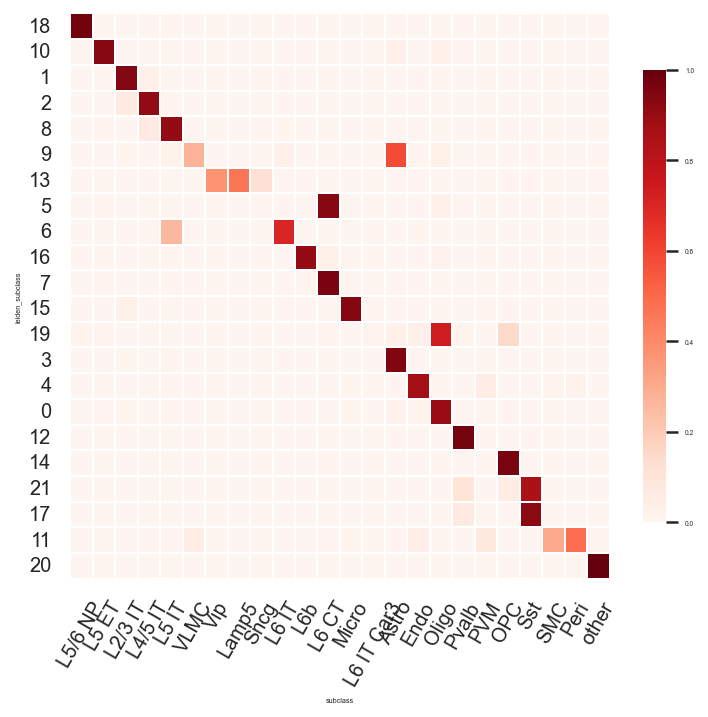

In [36]:
prediction_column = 'subclass_prediction_label'

ref_cluster_column = 'subclass'

# determine which class to query
query_cluster_column = 'leiden_subclass'
#query_cluster_column = 'leiden_cluster'

print('Predict cell types.')
clsf.predict_classes(nnc, adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = adata.obs[[query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')
    
# Plot
fig1=plt.figure(figsize = (6,5))
sns.set(font_scale=0.3)
#sns.heatmap(fractions_sorted, cmap='Greys', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .8})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 60)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(query_cluster_column)
plt.show()

In [55]:
sc.settings.n_jobs = 24
sc.settings.figdir = postanalysis_folder
sc.settings.set_figure_params(dpi=150, dpi_save=300, frameon=False, 
                              figsize=(4, 4), fontsize=8, facecolor='white',)

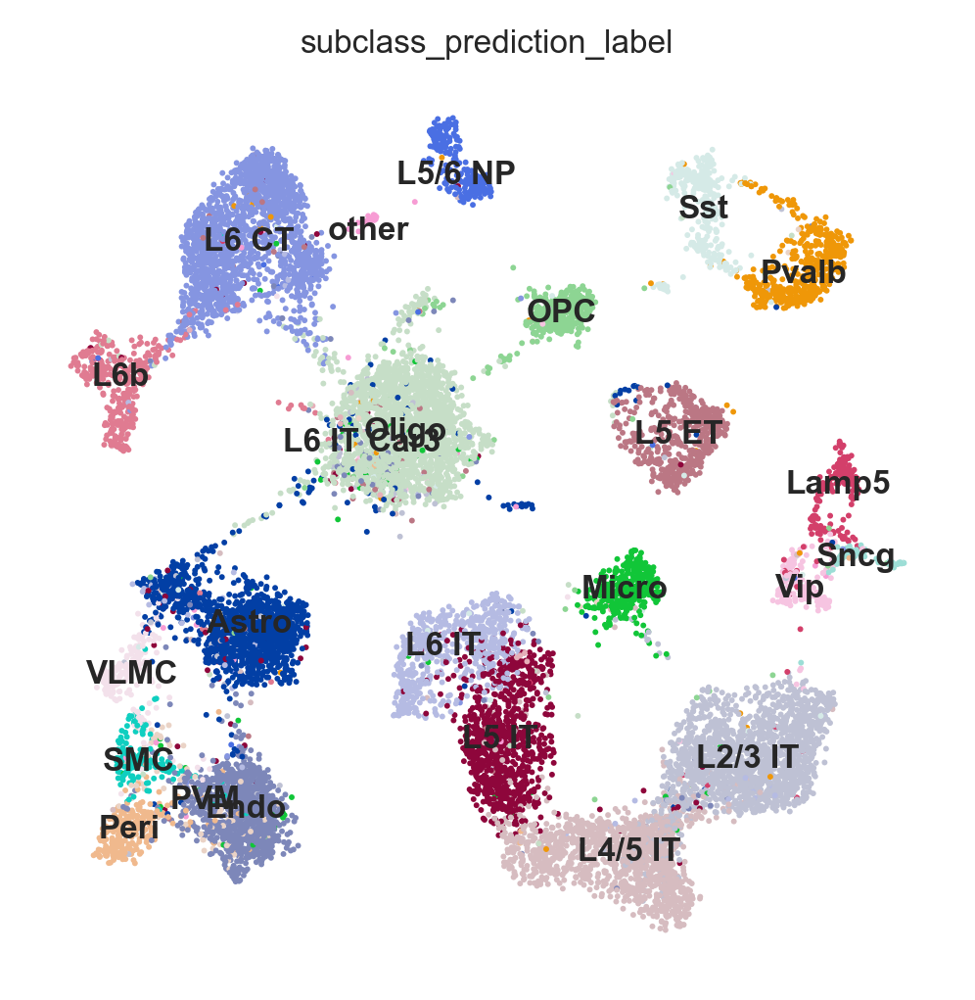

In [38]:
# Plot the predicted labels on UMAP to guide the manual labeling of the de novo clustering below
# use this to manually merge and split the original query column (e.g., leiden_subclass)
sc.pl.umap(adata, color='subclass_prediction_label', legend_loc='on data')

### plot clustering as ref

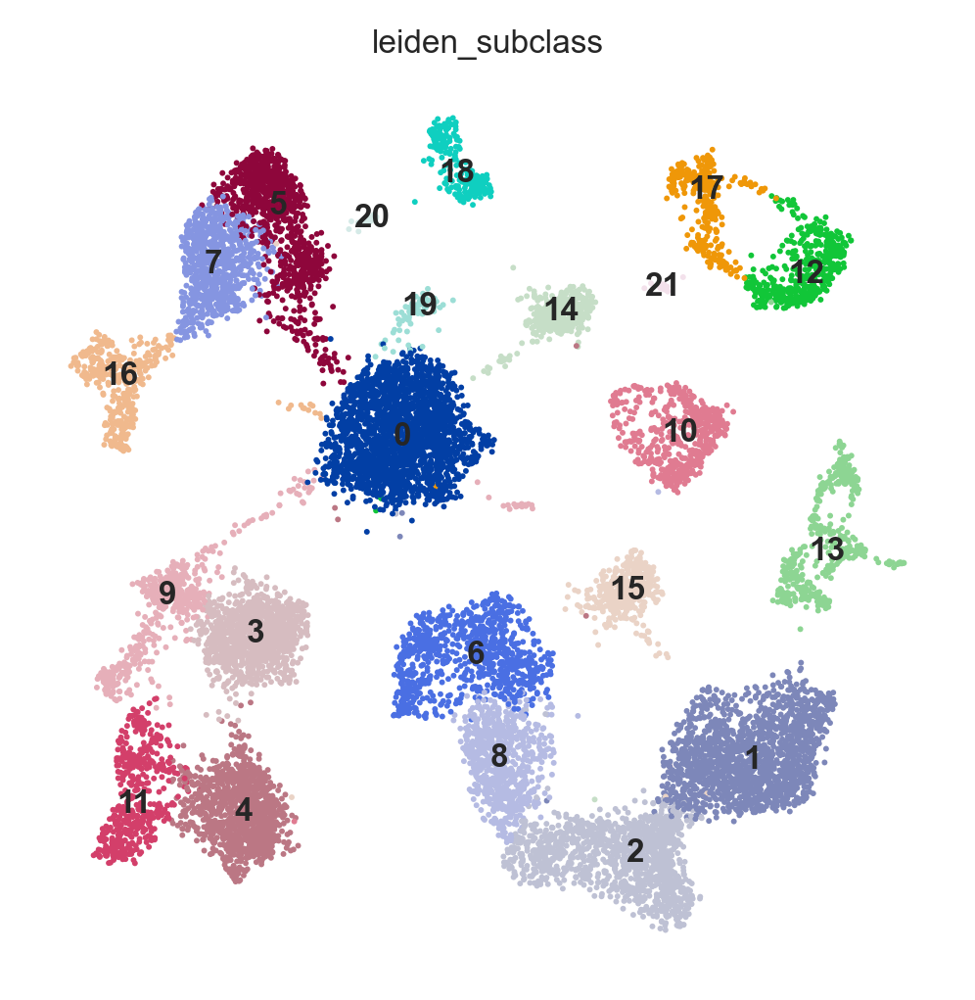

In [39]:
sc.pl.umap(adata, color='leiden_subclass', legend_loc='on data')

## 8.4 Split labels

by comparing two UMAP above, we could estimate which cluster should be further splitted

In [176]:
adata.obs['leiden_subclass_sub'] = adata.obs['leiden_subclass'] 
sc.tl.leiden(adata, resolution=0.3,restrict_to=('leiden_subclass_sub',['0']),
             key_added='leiden_subclass_sub')
sc.tl.leiden(adata, resolution=0.5,restrict_to=('leiden_subclass_sub',['13']),
             key_added='leiden_subclass_sub')
sc.tl.leiden(adata, resolution=1,restrict_to=('leiden_subclass_sub',['13,1']),
             key_added='leiden_subclass_sub')
#sc.tl.leiden(adata, resolution=0.8,restrict_to=('leiden_subclass_sub',['13,1,2']),
#             key_added='leiden_subclass_sub')
sc.tl.leiden(adata, resolution=0.2,restrict_to=('leiden_subclass_sub',['11']),
             key_added='leiden_subclass_sub')
sc.tl.leiden(adata, resolution=0.2,restrict_to=('leiden_subclass_sub',['9']),
             key_added='leiden_subclass_sub')
sc.tl.leiden(adata, resolution=0.5,restrict_to=('leiden_subclass_sub',['4']),
             key_added='leiden_subclass_sub')


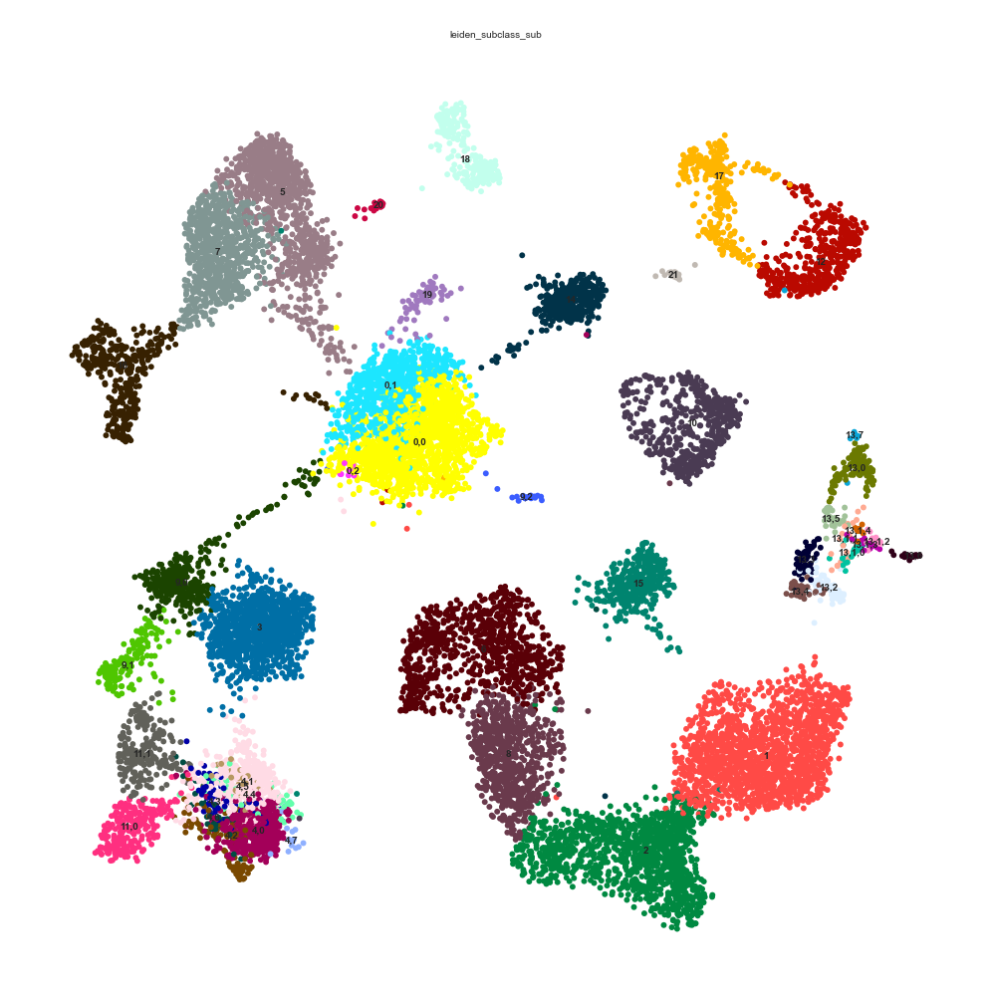

In [177]:
sc.pl.umap(adata, color='leiden_subclass_sub', legend_loc='on data', cmap='Spectral')

## 8.5 further predict splitted groups

Predict cell types.


C:\Users\puzheng\AppData\Local\Temp/ipykernel_30876/1454245228.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


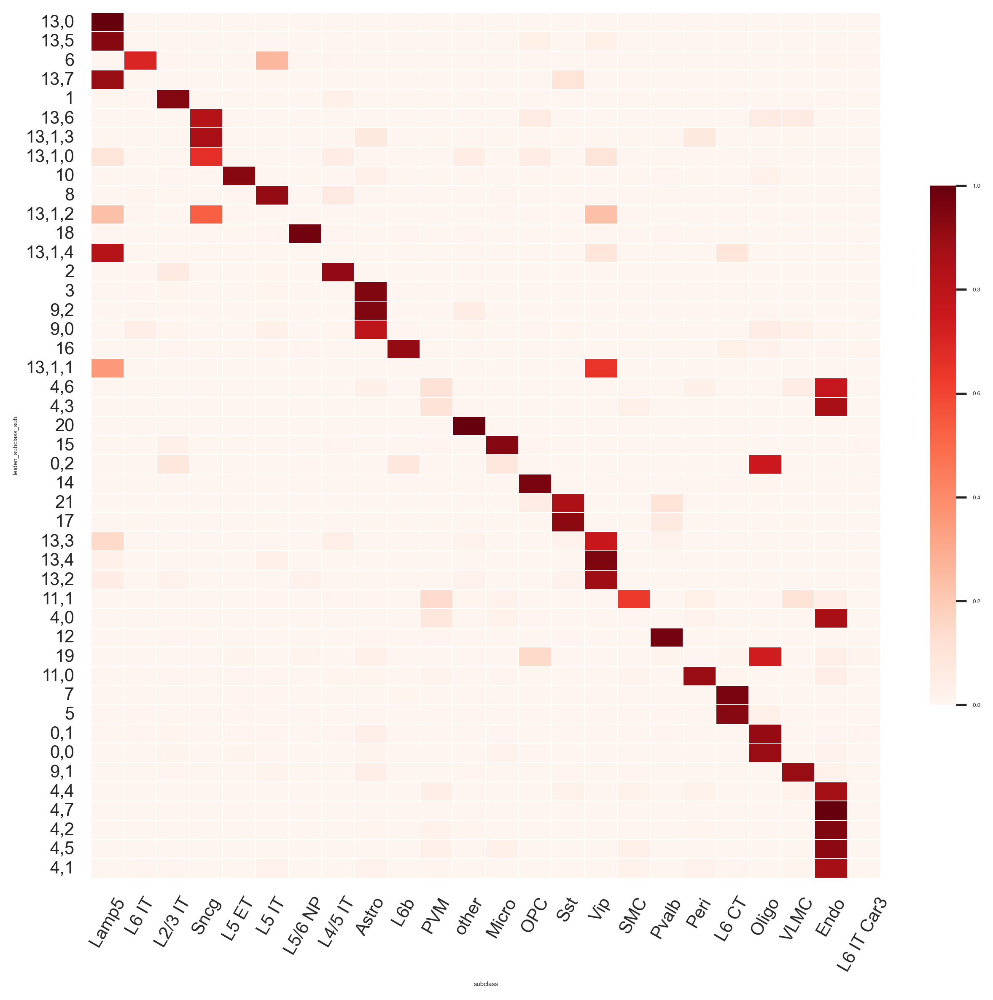

In [178]:
prediction_column = 'subclass_prediction_label'

ref_cluster_column = 'subclass'

# determine which class to query
query_cluster_column = 'leiden_subclass_sub'
#query_cluster_column = 'leiden_cluster'

print('Predict cell types.')
clsf.predict_classes(nnc, adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = adata.obs[[query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')
    
# Plot
fig1=plt.figure(figsize = (10,9))
sns.set(font_scale=0.3)
#sns.heatmap(fractions_sorted, cmap='Greys', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 60)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(query_cluster_column)
plt.show()

## 8.6 Assign most of uniquely classfied clusters

In [179]:
first_assign_dict = {}
# Automatic assign best fit if applicable
assign_th = 0.6
for _cluster, _vec in fractions.iterrows():
    #_cluster, _vec
    _matched_inds = np.where(_vec >= assign_th)[0]
    # if uniquely matched:
    if len(_matched_inds) == 1:
        print(_cluster, list(_vec.keys())[_matched_inds[0]])
        first_assign_dict[_cluster] = list(_vec.keys())[_matched_inds[0]]

0,0 Oligo
0,1 Oligo
0,2 Oligo
1 L2/3 IT
2 L4/5 IT
3 Astro
4,0 Endo
4,1 Endo
4,2 Endo
4,3 Endo
4,4 Endo
4,5 Endo
4,6 Endo
4,7 Endo
5 L6 CT
6 L6 IT
7 L6 CT
8 L5 IT
9,0 Astro
9,1 VLMC
9,2 Astro
10 L5 ET
11,0 Peri
11,1 SMC
12 Pvalb
13,0 Lamp5
13,1,0 Sncg
13,1,1 Vip
13,1,3 Sncg
13,1,4 Lamp5
13,2 Vip
13,3 Vip
13,4 Vip
13,5 Lamp5
13,6 Sncg
13,7 Lamp5
14 OPC
15 Micro
16 L6b
17 Sst
18 L5/6 NP
19 Oligo
20 other
21 Sst


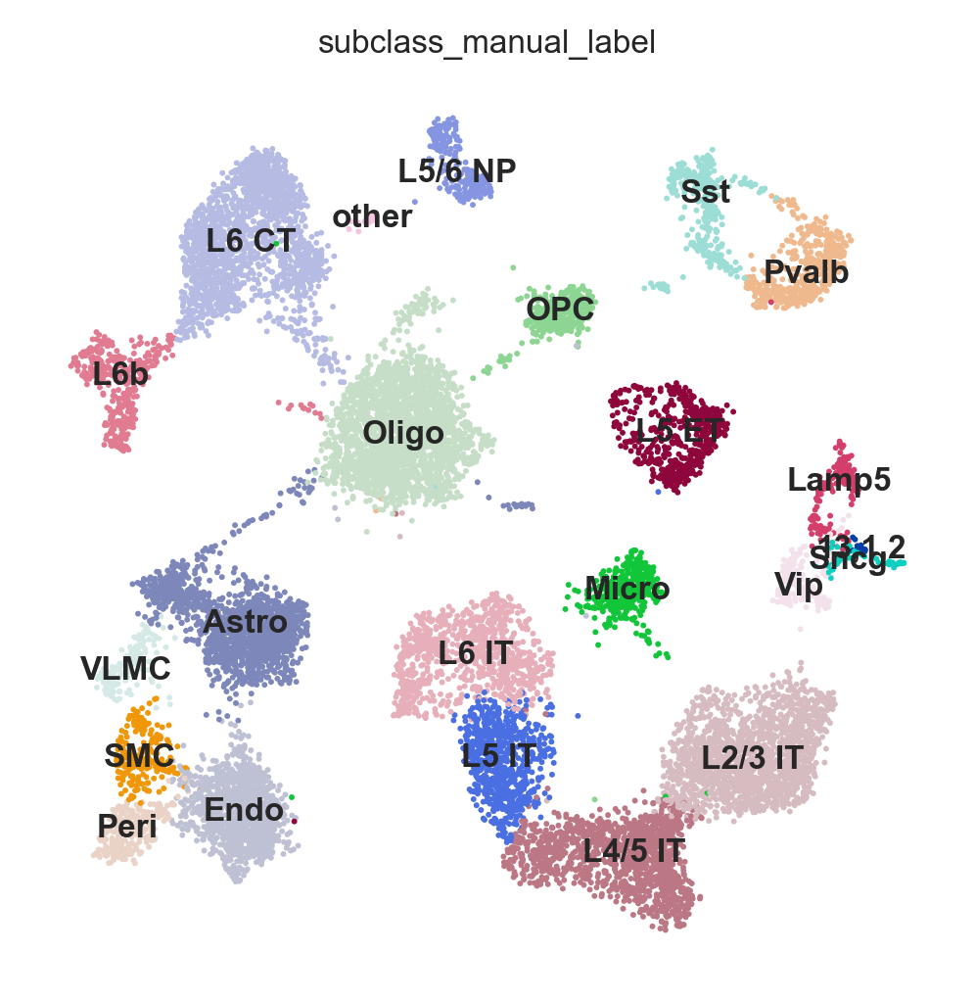

In [183]:
adata.obs['subclass_manual_label'] = adata.obs['leiden_subclass_sub'] 
adata.obs = adata.obs.replace({'subclass_manual_label':first_assign_dict})
# Check the leftover
np.unique(adata.obs['subclass_manual_label'])
# Plot the predicted sub-subclass
sc.pl.umap(adata, color='subclass_manual_label', legend_loc='on data',)

## 8.7 Manual assign leftovers

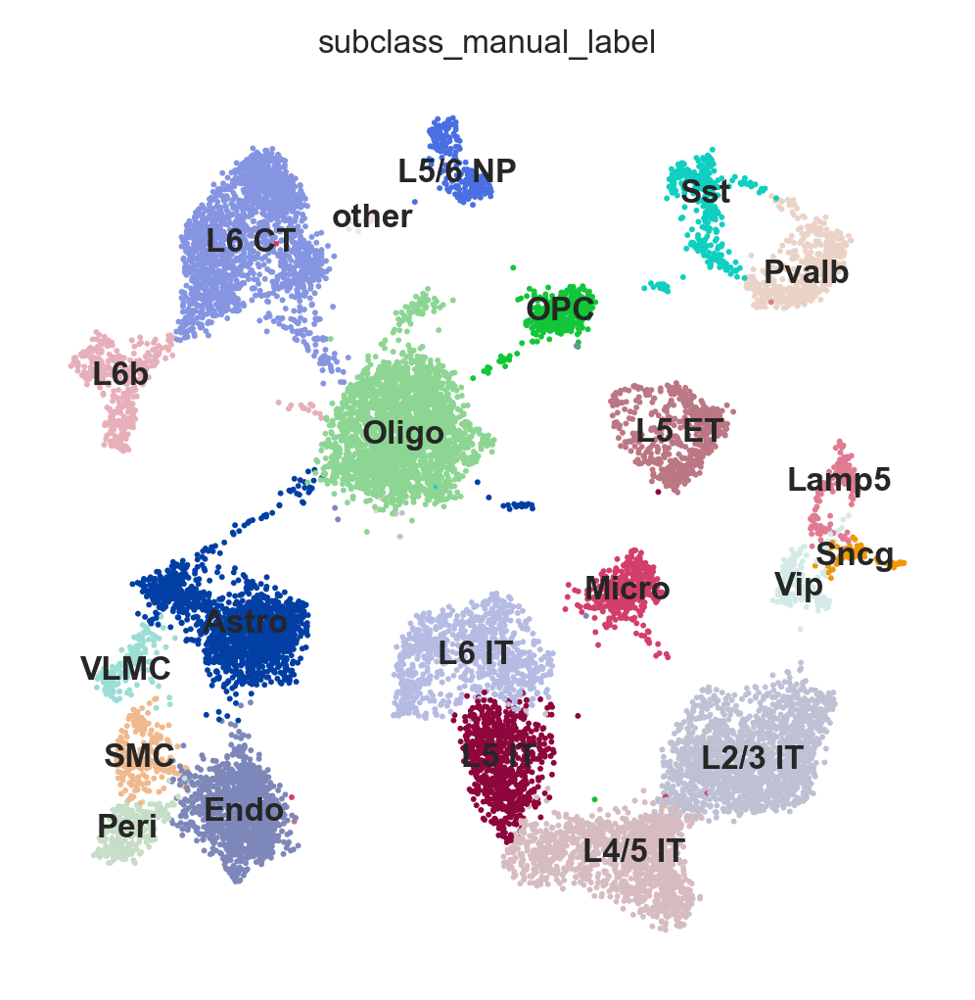

In [182]:
#adata.obs = adata.obs.replace({'subclass_manual_label':{'6':'L6 IT'}})
#adata.obs = adata.obs.replace({'subclass_manual_label':{'9,0':'Astro'}})
#adata.obs = adata.obs.replace({'subclass_manual_label':{'11,1':'SMC'}})
#adata.obs = adata.obs.replace({'subclass_manual_label':{'19':'Oligo', '0,2':'Oligo'}})
adata.obs = adata.obs.replace({'subclass_manual_label':{'13,1,2':'Sncg'}})
#adata.obs = adata.obs.replace({'subclass_manual_label':{'13,3':'Vip'}})

np.unique(adata.obs['subclass_manual_label'])

sc.pl.umap(adata, color='subclass_manual_label', legend_loc='on data',)

# 9. Redo prediction for manual labels

Check consistency between manual labels vs. predict labels

Predict cell types: subclass_manual_label


C:\Users\puzheng\AppData\Local\Temp/ipykernel_30876/1525045723.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


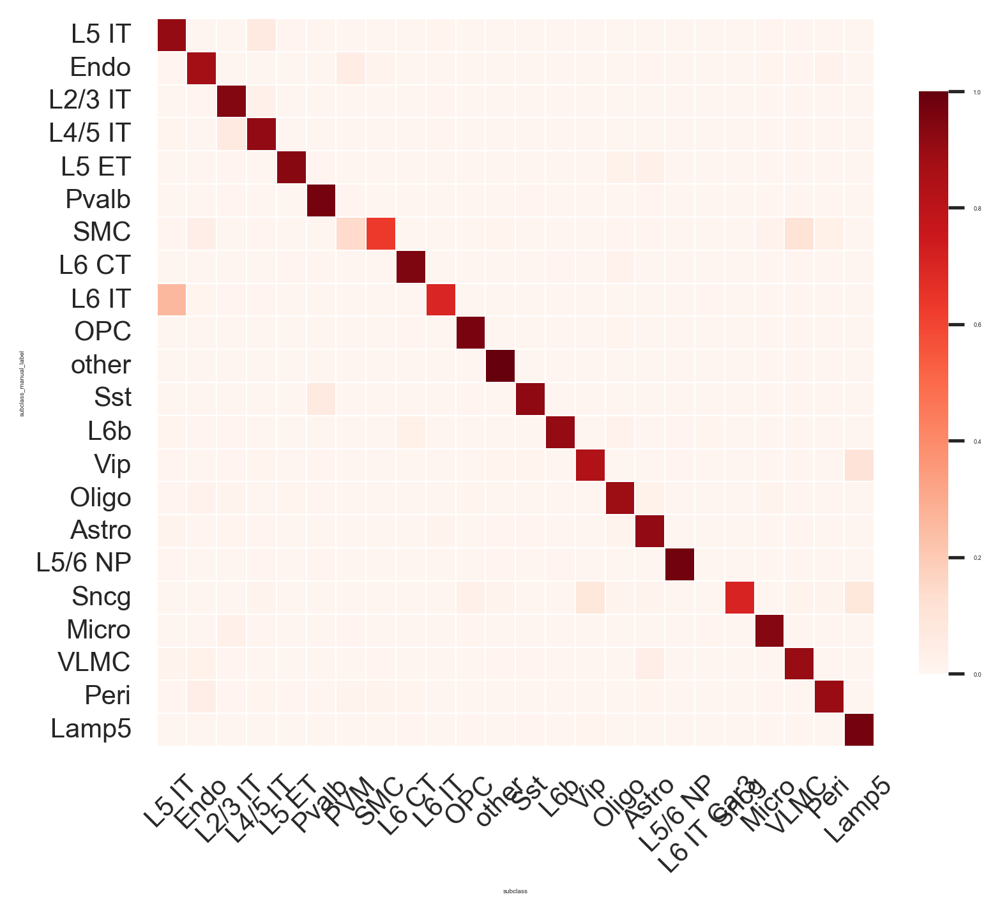

In [174]:
prediction_column = 'subclass_manual_label_predict'

ref_cluster_column = 'subclass'

# determine which class to query
query_cluster_column = 'subclass_manual_label'

print(f'Predict cell types: {query_cluster_column}')
clsf.predict_classes(nnc, adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = adata.obs[[query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')
    
# Plot
fig1=plt.figure(figsize = (6,5))
sns.set(font_scale=0.2)

sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .8})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 45)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(query_cluster_column)
plt.show()

# 10. Save manually labeled data

In [175]:
save_filename = os.path.join(os.path.join(postanalysis_folder, 'manual_labeled_data.h5ad'))

overwrite = True

if not os.path.exists(save_filename) or overwrite:
    print(f"save adata into file: {save_filename}")
    adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save adata into file: \\mendel\Mendel_SSD3\MERFISH_Analysis\20220415-M1_renamed_storm65\PostAnalysis\manual_labeled_data.h5ad
